# Stable Diffusion Super Resolution (4x Upscaler)

This notebook implements the **Stable Diffusion x4 Upscaler** model to enhance image resolution by a factor of 4.

**Model:** `stabilityai/stable-diffusion-x4-upscaler`

**Reference:** [HuggingFace Diffusers Documentation](https://huggingface.co/docs/diffusers/main/api/pipelines/stable_diffusion/upscale)

## 1. Setup and Installation

In [1]:
# Install required packages (using Colab's pre-installed torch to avoid version conflicts)
!pip install -q diffusers transformers accelerate safetensors

# Note: We use Colab's pre-installed PyTorch to avoid dependency conflicts
# If you still see warnings, they can usually be ignored as long as the code runs

In [3]:
# Import libraries
import torch
from diffusers import StableDiffusionUpscalePipeline
from PIL import Image
import os
from google.colab import files
import requests
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np

## 2. Check GPU Availability

In [4]:
# Check if GPU is available
if torch.cuda.is_available():
    device = "cuda"
    print(f"GPU available: {torch.cuda.get_device_name(0)}")
    print(f"GPU Memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")
else:
    device = "cpu"
    print("No GPU available. Running on CPU (will be slower)")

GPU available: Tesla T4
GPU Memory: 15.83 GB


## 3. Load the Super Resolution Model

In [5]:
# Load the Stable Diffusion x4 Upscaler pipeline
model_id = "stabilityai/stable-diffusion-x4-upscaler"

print("Loading model... (this may take a few minutes on first run)")

# Load with fp16 for faster inference and lower memory usage
pipeline = StableDiffusionUpscalePipeline.from_pretrained(
    model_id,
    variant="fp16",
    torch_dtype=torch.float16
)

# Move to GPU
pipeline = pipeline.to(device)

# Enable memory efficient attention (helps with memory)
pipeline.enable_attention_slicing()

print("Model loaded successfully!")

Loading model... (this may take a few minutes on first run)


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/485 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/634 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

scheduler_config.json:   0%|          | 0.00/300 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/348 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/825 [00:00<?, ?B/s]

text_encoder/model.fp16.safetensors:   0%|          | 0.00/681M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/587 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/982 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.fp16.safete(…):   0%|          | 0.00/947M [00:00<?, ?B/s]

vae/diffusion_pytorch_model.fp16.safeten(…):   0%|          | 0.00/111M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


Model loaded successfully!


## 4. Upload Your Images

You have two options:
- **Option A:** Upload images directly from your computer
- **Option B:** Mount Google Drive and use images from there

In [6]:
# Option A: Upload images directly
print("Upload your images (select one or multiple files):")
uploaded = files.upload()

# Create input directory and save uploaded files
os.makedirs("input_images", exist_ok=True)
for filename in uploaded.keys():
    with open(f"input_images/{filename}", "wb") as f:
        f.write(uploaded[filename])
    print(f"Saved: {filename}")

INPUT_DIR = "input_images"

Upload your images (select one or multiple files):


Saving cropped_SM_1_IMG_0434_20220328_025300__003204.JPG to cropped_SM_1_IMG_0434_20220328_025300__003204.JPG
Saving cropped_SM_1_IMG_0542_20220330_073400__003904.JPG to cropped_SM_1_IMG_0542_20220330_073400__003904.JPG
Saving cropped_SM_1_IMG_1056_20230705_200100__007959.JPG to cropped_SM_1_IMG_1056_20230705_200100__007959.JPG
Saving cropped_SM_1_IMG_1075_20230706_144800__008850.JPG to cropped_SM_1_IMG_1075_20230706_144800__008850.JPG
Saving cropped_SM_1_IMG_1481_20220422_122400__004262.JPG to cropped_SM_1_IMG_1481_20220422_122400__004262.JPG
Saving cropped_SM_1_IMG_3349_20231126_053100__012427.JPG to cropped_SM_1_IMG_3349_20231126_053100__012427.JPG
Saving cropped_SM_1_IMG_6311_20240106_174700__016179.JPG to cropped_SM_1_IMG_6311_20240106_174700__016179.JPG
Saving cropped_SM_2_IMG_8727_20220426_005400__028726.JPG to cropped_SM_2_IMG_8727_20220426_005400__028726.JPG
Saving cropped_SM_3_IMG_0075_20220511_010700__046832.JPG to cropped_SM_3_IMG_0075_20220511_010700__046832.JPG
Saving cro

In [7]:
# Upload images to upscaled_images folder
print("Upload your upscaled images:")
uploaded = files.upload()

os.makedirs("upscaled_images", exist_ok=True)
for filename in uploaded.keys():
    with open(f"upscaled_images/{filename}", "wb") as f:
        f.write(uploaded[filename])
    print(f"Saved: {filename}")

Upload your upscaled images:


In [ ]:
# Option B: Mount Google Drive (uncomment and run if you prefer this method)
# from google.colab import drive
# drive.mount('/content/drive')
# INPUT_DIR = "/content/drive/MyDrive/your_image_folder"  # Change this path

## 5. Define Upscaling Function

In [8]:
def upscale_image(
    image_path,
    prompt="high quality, detailed, sharp",
    negative_prompt="blurry, low quality, artifacts, noise",
    num_inference_steps=75,
    guidance_scale=9.0,
    noise_level=20
):
    """
    Upscale a single image using Stable Diffusion x4 Upscaler.

    Parameters:
    -----------
    image_path : str
        Path to the input image
    prompt : str
        Text prompt to guide the upscaling (describes desired output quality)
    negative_prompt : str
        What to avoid in the output
    num_inference_steps : int
        Number of denoising steps (more = better quality but slower)
    guidance_scale : float
        How strongly to follow the prompt (7-10 is typical)
    noise_level : int
        Amount of noise to add to low-res image (0-350, lower = more faithful)

    Returns:
    --------
    PIL.Image : Upscaled image
    """
    # Load and prepare the image
    low_res_img = Image.open(image_path).convert("RGB")
    original_size = low_res_img.size

    # The model works best with images around 128x128 to 512x512
    # If image is too large, we may need to resize it first
    max_input_size = 512
    if max(low_res_img.size) > max_input_size:
        ratio = max_input_size / max(low_res_img.size)
        new_size = (int(low_res_img.size[0] * ratio), int(low_res_img.size[1] * ratio))
        low_res_img = low_res_img.resize(new_size, Image.LANCZOS)
        print(f"   Resized input from {original_size} to {low_res_img.size} for processing")

    # Run the upscaling pipeline
    upscaled_image = pipeline(
        prompt=prompt,
        image=low_res_img,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        noise_level=noise_level,
        negative_prompt=negative_prompt
    ).images[0]

    return upscaled_image, low_res_img

## 6. Process All Images

In [9]:
# Configuration
OUTPUT_DIR = "upscaled_images"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Upscaling parameters (adjust as needed)
PROMPT = "high quality, detailed, sharp, 4k, professional"  # Customize this!
NEGATIVE_PROMPT = "blurry, low quality, artifacts, noise, pixelated"
NUM_INFERENCE_STEPS = 50  # Increase for better quality (but slower)
GUIDANCE_SCALE = 9.0  # Higher = more prompt influence
NOISE_LEVEL = 20  # Lower = more faithful to original

# Get list of images
image_extensions = ('.png', '.jpg', '.jpeg', '.webp', '.bmp')
image_files = [f for f in os.listdir(INPUT_DIR) if f.lower().endswith(image_extensions)]

print(f"Found {len(image_files)} images to process\n")

# Process each image
results = []
for i, filename in enumerate(image_files, 1):
    print(f"Processing [{i}/{len(image_files)}]: {filename}")

    input_path = os.path.join(INPUT_DIR, filename)
    output_filename = f"upscaled_{filename}"
    output_path = os.path.join(OUTPUT_DIR, output_filename)

    try:
        # Upscale the image
        upscaled_img, low_res_img = upscale_image(
            input_path,
            prompt=PROMPT,
            negative_prompt=NEGATIVE_PROMPT,
            num_inference_steps=NUM_INFERENCE_STEPS,
            guidance_scale=GUIDANCE_SCALE,
            noise_level=NOISE_LEVEL
        )

        # Save the result
        upscaled_img.save(output_path)

        results.append({
            'filename': filename,
            'input_size': low_res_img.size,
            'output_size': upscaled_img.size,
            'status': 'success'
        })

        print(f"   Saved: {output_path}")
        print(f"   Size: {low_res_img.size} -> {upscaled_img.size}\n")

    except Exception as e:
        results.append({'filename': filename, 'status': 'failed', 'error': str(e)})
        print(f"   Error: {e}\n")

print("\n" + "="*50)
print(f"Processing complete! {sum(1 for r in results if r['status'] == 'success')}/{len(image_files)} images upscaled")
print(f"Output directory: {OUTPUT_DIR}")

Found 13 images to process

Processing [1/13]: cropped_SM_1_IMG_1481_20220422_122400__004262.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

   Saved: upscaled_images/upscaled_cropped_SM_1_IMG_1481_20220422_122400__004262.JPG
   Size: (140, 142) -> (560, 560)

Processing [2/13]: cropped1_SM_4_IMG_1089_20230114_143700__056249.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

   Saved: upscaled_images/upscaled_cropped1_SM_4_IMG_1089_20230114_143700__056249.JPG
   Size: (156, 134) -> (624, 528)

Processing [3/13]: cropped_SM_1_IMG_3349_20231126_053100__012427.JPG
   Resized input from (804, 880) to (467, 512) for processing


  0%|          | 0/50 [00:00<?, ?it/s]

   Saved: upscaled_images/upscaled_cropped_SM_1_IMG_3349_20231126_053100__012427.JPG
   Size: (467, 512) -> (1856, 2048)

Processing [4/13]: cropped2_SM_4_IMG_1089_20230114_143700__056249.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

   Saved: upscaled_images/upscaled_cropped2_SM_4_IMG_1089_20230114_143700__056249.JPG
   Size: (144, 162) -> (576, 640)

Processing [5/13]: cropped_SM_2_IMG_8727_20220426_005400__028726.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

   Saved: upscaled_images/upscaled_cropped_SM_2_IMG_8727_20220426_005400__028726.JPG
   Size: (354, 290) -> (1408, 1152)

Processing [6/13]: cropped_SM_1_IMG_1075_20230706_144800__008850.JPG
   Resized input from (680, 718) to (484, 512) for processing


  0%|          | 0/50 [00:00<?, ?it/s]

   Error: CUDA out of memory. Tried to allocate 3.78 GiB. GPU 0 has a total capacity of 14.74 GiB of which 1.78 GiB is free. Process 5585 has 12.96 GiB memory in use. Of the allocated memory 8.36 GiB is allocated by PyTorch, and 4.47 GiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

Processing [7/13]: cropped_SM_4_IMG_1822_20230213_133300__055819.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

   Saved: upscaled_images/upscaled_cropped_SM_4_IMG_1822_20230213_133300__055819.JPG
   Size: (266, 402) -> (1056, 1600)

Processing [8/13]: cropped_SM_1_IMG_0434_20220328_025300__003204.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

   Saved: upscaled_images/upscaled_cropped_SM_1_IMG_0434_20220328_025300__003204.JPG
   Size: (306, 448) -> (1216, 1792)

Processing [9/13]: cropped_SM_4_IMG_1089_20230114_143700__056249.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

   Saved: upscaled_images/upscaled_cropped_SM_4_IMG_1089_20230114_143700__056249.JPG
   Size: (144, 176) -> (576, 704)

Processing [10/13]: cropped_SM_3_IMG_0075_20220511_010700__046832.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

   Saved: upscaled_images/upscaled_cropped_SM_3_IMG_0075_20220511_010700__046832.JPG
   Size: (162, 298) -> (640, 1184)

Processing [11/13]: cropped_SM_1_IMG_0542_20220330_073400__003904.JPG
   Resized input from (592, 444) to (512, 384) for processing


  0%|          | 0/50 [00:00<?, ?it/s]

   Error: CUDA out of memory. Tried to allocate 3.00 GiB. GPU 0 has a total capacity of 14.74 GiB of which 1.78 GiB is free. Process 5585 has 12.96 GiB memory in use. Of the allocated memory 6.99 GiB is allocated by PyTorch, and 5.84 GiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

Processing [12/13]: cropped_SM_1_IMG_6311_20240106_174700__016179.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

   Saved: upscaled_images/upscaled_cropped_SM_1_IMG_6311_20240106_174700__016179.JPG
   Size: (216, 250) -> (864, 992)

Processing [13/13]: cropped_SM_1_IMG_1056_20230705_200100__007959.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

   Saved: upscaled_images/upscaled_cropped_SM_1_IMG_1056_20230705_200100__007959.JPG
   Size: (234, 250) -> (928, 992)


Processing complete! 11/13 images upscaled
Output directory: upscaled_images


RESIZING IMAGES

In [12]:
import os
from PIL import Image

os.makedirs("input_images_256", exist_ok=True)
os.makedirs("input_images_128", exist_ok=True)

def resize_max_dimension(img, max_size):
    """Resize so longest side equals max_size, preserve aspect ratio"""
    ratio = max_size / max(img.size)
    new_size = (int(img.size[0] * ratio), int(img.size[1] * ratio))
    return img.resize(new_size, Image.LANCZOS)

for filename in os.listdir("input_images"):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        img = Image.open(f"input_images/{filename}").convert("RGB")

        # Resize to max 256
        img_256 = resize_max_dimension(img, 256)
        img_256.save(f"input_images_256/{filename}")

        # Resize to max 128
        img_128 = resize_max_dimension(img, 128)
        img_128.save(f"input_images_128/{filename}")

        print(f"{filename}: {img.size} → {img_256.size}, {img_128.size}")

print("\nDone!")

cropped_SM_1_IMG_1481_20220422_122400__004262.JPG: (140, 142) → (252, 256), (126, 128)
cropped1_SM_4_IMG_1089_20230114_143700__056249.JPG: (156, 134) → (256, 219), (128, 109)
cropped_SM_1_IMG_3349_20231126_053100__012427.JPG: (804, 880) → (233, 256), (116, 128)
cropped2_SM_4_IMG_1089_20230114_143700__056249.JPG: (144, 162) → (227, 256), (113, 128)
cropped_SM_2_IMG_8727_20220426_005400__028726.JPG: (354, 290) → (256, 209), (128, 104)
cropped_SM_1_IMG_1075_20230706_144800__008850.JPG: (680, 718) → (242, 256), (121, 128)
cropped_SM_4_IMG_1822_20230213_133300__055819.JPG: (266, 402) → (169, 256), (84, 128)
cropped_SM_1_IMG_0434_20220328_025300__003204.JPG: (306, 448) → (174, 256), (87, 128)
cropped_SM_4_IMG_1089_20230114_143700__056249.JPG: (144, 176) → (209, 256), (104, 128)
cropped_SM_3_IMG_0075_20220511_010700__046832.JPG: (162, 298) → (139, 256), (69, 128)
cropped_SM_1_IMG_0542_20220330_073400__003904.JPG: (592, 444) → (256, 192), (128, 96)
cropped_SM_1_IMG_6311_20240106_174700__016179

RUNNING UPSCALER ON RESIZED IMAGES

In [13]:
# Upscale 256x256 images
OUTPUT_DIR_256 = "upscaled_images_256"
os.makedirs(OUTPUT_DIR_256, exist_ok=True)

PROMPT = "high quality, detailed, sharp, 4k"
NEGATIVE_PROMPT = "blurry, low quality, artifacts, noise"

print("=== Processing 256x256 images ===\n")

for filename in os.listdir("input_images_256"):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        print(f"Processing: {filename}")
        img = Image.open(f"input_images_256/{filename}").convert("RGB")

        upscaled = pipeline(
            prompt=PROMPT,
            image=img,
            num_inference_steps=50,
            guidance_scale=9.0,
            noise_level=20,
            negative_prompt=NEGATIVE_PROMPT
        ).images[0]

        upscaled.save(f"{OUTPUT_DIR_256}/upscaled_{filename}")
        print(f"  {img.size} → {upscaled.size}")

print("\nDone with 256x256!")

=== Processing 256x256 images ===

Processing: cropped_SM_1_IMG_1481_20220422_122400__004262.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (252, 256) → (1008, 1024)
Processing: cropped1_SM_4_IMG_1089_20230114_143700__056249.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (256, 219) → (1024, 864)
Processing: cropped_SM_1_IMG_3349_20231126_053100__012427.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (233, 256) → (928, 1024)
Processing: cropped2_SM_4_IMG_1089_20230114_143700__056249.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (227, 256) → (896, 1024)
Processing: cropped_SM_2_IMG_8727_20220426_005400__028726.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (256, 209) → (1024, 832)
Processing: cropped_SM_1_IMG_1075_20230706_144800__008850.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (242, 256) → (960, 1024)
Processing: cropped_SM_4_IMG_1822_20230213_133300__055819.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (169, 256) → (672, 1024)
Processing: cropped_SM_1_IMG_0434_20220328_025300__003204.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (174, 256) → (688, 1024)
Processing: cropped_SM_4_IMG_1089_20230114_143700__056249.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (209, 256) → (832, 1024)
Processing: cropped_SM_3_IMG_0075_20220511_010700__046832.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (139, 256) → (544, 1024)
Processing: cropped_SM_1_IMG_0542_20220330_073400__003904.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (256, 192) → (1024, 768)
Processing: cropped_SM_1_IMG_6311_20240106_174700__016179.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (221, 256) → (880, 1024)
Processing: cropped_SM_1_IMG_1056_20230705_200100__007959.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (239, 256) → (944, 1024)

Done with 256x256!


In [14]:
# Upscale 128x128 images
OUTPUT_DIR_128 = "upscaled_images_128"
os.makedirs(OUTPUT_DIR_128, exist_ok=True)

print("=== Processing 128x128 images ===\n")

for filename in os.listdir("input_images_128"):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        print(f"Processing: {filename}")
        img = Image.open(f"input_images_128/{filename}").convert("RGB")

        upscaled = pipeline(
            prompt=PROMPT,
            image=img,
            num_inference_steps=50,
            guidance_scale=9.0,
            noise_level=20,
            negative_prompt=NEGATIVE_PROMPT
        ).images[0]

        upscaled.save(f"{OUTPUT_DIR_128}/upscaled_{filename}")
        print(f"  {img.size} → {upscaled.size}")

print("\nDone with 128x128!")

=== Processing 128x128 images ===

Processing: cropped_SM_1_IMG_1481_20220422_122400__004262.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (126, 128) → (496, 512)
Processing: cropped1_SM_4_IMG_1089_20230114_143700__056249.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (128, 109) → (512, 432)
Processing: cropped_SM_1_IMG_3349_20231126_053100__012427.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (116, 128) → (464, 512)
Processing: cropped2_SM_4_IMG_1089_20230114_143700__056249.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (113, 128) → (448, 512)
Processing: cropped_SM_2_IMG_8727_20220426_005400__028726.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (128, 104) → (512, 416)
Processing: cropped_SM_1_IMG_1075_20230706_144800__008850.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (121, 128) → (480, 512)
Processing: cropped_SM_4_IMG_1822_20230213_133300__055819.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (84, 128) → (336, 512)
Processing: cropped_SM_1_IMG_0434_20220328_025300__003204.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (87, 128) → (336, 512)
Processing: cropped_SM_4_IMG_1089_20230114_143700__056249.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (104, 128) → (416, 512)
Processing: cropped_SM_3_IMG_0075_20220511_010700__046832.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (69, 128) → (272, 512)
Processing: cropped_SM_1_IMG_0542_20220330_073400__003904.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (128, 96) → (512, 384)
Processing: cropped_SM_1_IMG_6311_20240106_174700__016179.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (110, 128) → (432, 512)
Processing: cropped_SM_1_IMG_1056_20230705_200100__007959.JPG


  0%|          | 0/50 [00:00<?, ?it/s]

  (119, 128) → (464, 512)

Done with 128x128!


In [17]:
!pip install -q pyiqa

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 28.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.4/129.4 kB 10.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.8/46.8 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.0/178.0 kB 15.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 276.2/276.2 kB 26.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 121.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 333.2/333.2 kB 31.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.4/59.4 MB 15.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.6/59.6 kB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 299.4/299.4 kB 28.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 226.4/226.4 kB 22.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [18]:
import pyiqa
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"

niqe = pyiqa.create_metric('niqe', device=device)
clipiqa = pyiqa.create_metric('clipiqa', device=device)

Downloading: "https://huggingface.co/chaofengc/IQA-PyTorch-Weights/resolve/main/niqe_modelparameters.mat" to /root/.cache/torch/hub/pyiqa/niqe_modelparameters.mat



100%|██████████| 8.15k/8.15k [00:00<00:00, 20.0MB/s]
100%|███████████████████████████████████████| 244M/244M [00:16<00:00, 15.9MiB/s]


In [20]:
import os

print("=== Quality Metrics Comparison ===\n")

results = []

for filename in os.listdir("input_images_256"):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        # 256 paths
        in_256 = f"input_images_256/{filename}"
        out_256 = f"upscaled_images_256/upscaled_{filename}"

        # 128 paths
        out_128 = f"upscaled_images_128/upscaled_{filename}"

        results.append({
            'file': filename,
            'in_256_niqe': niqe(in_256).item(),
            'out_256_niqe': niqe(out_256).item(),
            'out_128_niqe': niqe(out_128).item(),
            'out_256_clip': clipiqa(out_256).item(),
            'out_128_clip': clipiqa(out_128).item(),
        })
        print(f"Evaluated: {filename}")

# Print summary
print(f"\n{'='*80}")
print(f"{'File':<45} {'256 out NIQE':<12} {'128 out NIQE':<12} {'256 CLIP':<10} {'128 CLIP':<10}")
print(f"{'='*80}")

for r in results:
    print(f"{r['file']:<45} {r['out_256_niqe']:.2f}         {r['out_128_niqe']:.2f}         {r['out_256_clip']:.3f}      {r['out_128_clip']:.3f}")

# Average summary
print(f"\n{'='*80}")
print("AVERAGES (outputs only):")
avg_256_niqe = sum(r['out_256_niqe'] for r in results) / len(results)
avg_128_niqe = sum(r['out_128_niqe'] for r in results) / len(results)
avg_256_clip = sum(r['out_256_clip'] for r in results) / len(results)
avg_128_clip = sum(r['out_128_clip'] for r in results) / len(results)

print(f"  From 256x256 input: NIQE={avg_256_niqe:.2f}, CLIP-IQA={avg_256_clip:.3f}")
print(f"  From 128x128 input: NIQE={avg_128_niqe:.2f}, CLIP-IQA={avg_128_clip:.3f}")
print(f"\n  Better NIQE: {'256 input' if avg_256_niqe < avg_128_niqe else '128 input'} (lower is better)")
print(f"  Better CLIP-IQA: {'256 input' if avg_256_clip > avg_128_clip else '128 input'} (higher is better)")

=== Quality Metrics Comparison ===

Evaluated: cropped_SM_1_IMG_1481_20220422_122400__004262.JPG
Evaluated: cropped1_SM_4_IMG_1089_20230114_143700__056249.JPG
Evaluated: cropped_SM_1_IMG_3349_20231126_053100__012427.JPG
Evaluated: cropped2_SM_4_IMG_1089_20230114_143700__056249.JPG
Evaluated: cropped_SM_2_IMG_8727_20220426_005400__028726.JPG
Evaluated: cropped_SM_1_IMG_1075_20230706_144800__008850.JPG
Evaluated: cropped_SM_4_IMG_1822_20230213_133300__055819.JPG
Evaluated: cropped_SM_1_IMG_0434_20220328_025300__003204.JPG
Evaluated: cropped_SM_4_IMG_1089_20230114_143700__056249.JPG
Evaluated: cropped_SM_3_IMG_0075_20220511_010700__046832.JPG
Evaluated: cropped_SM_1_IMG_0542_20220330_073400__003904.JPG
Evaluated: cropped_SM_1_IMG_6311_20240106_174700__016179.JPG
Evaluated: cropped_SM_1_IMG_1056_20230705_200100__007959.JPG

File                                          256 out NIQE 128 out NIQE 256 CLIP   128 CLIP  
cropped_SM_1_IMG_1481_20220422_122400__004262.JPG 9.32         5.12       

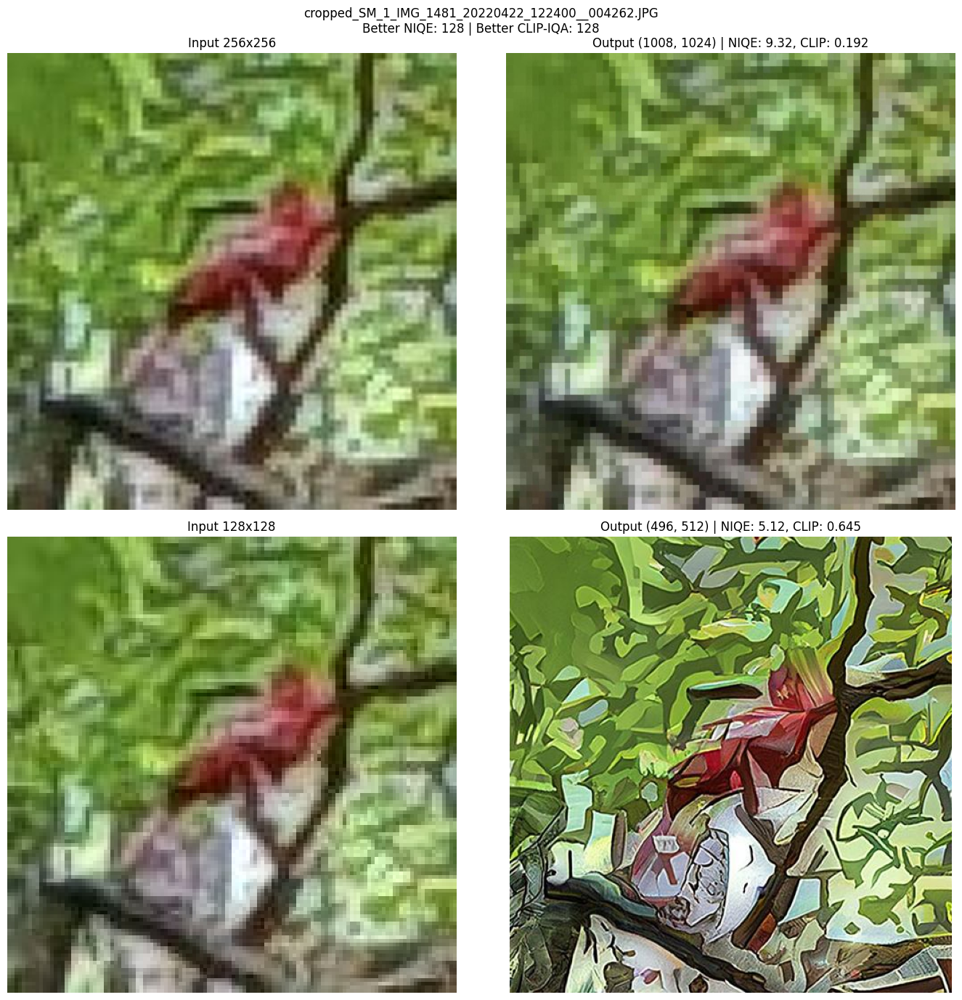

--------------------------------------------------------------------------------


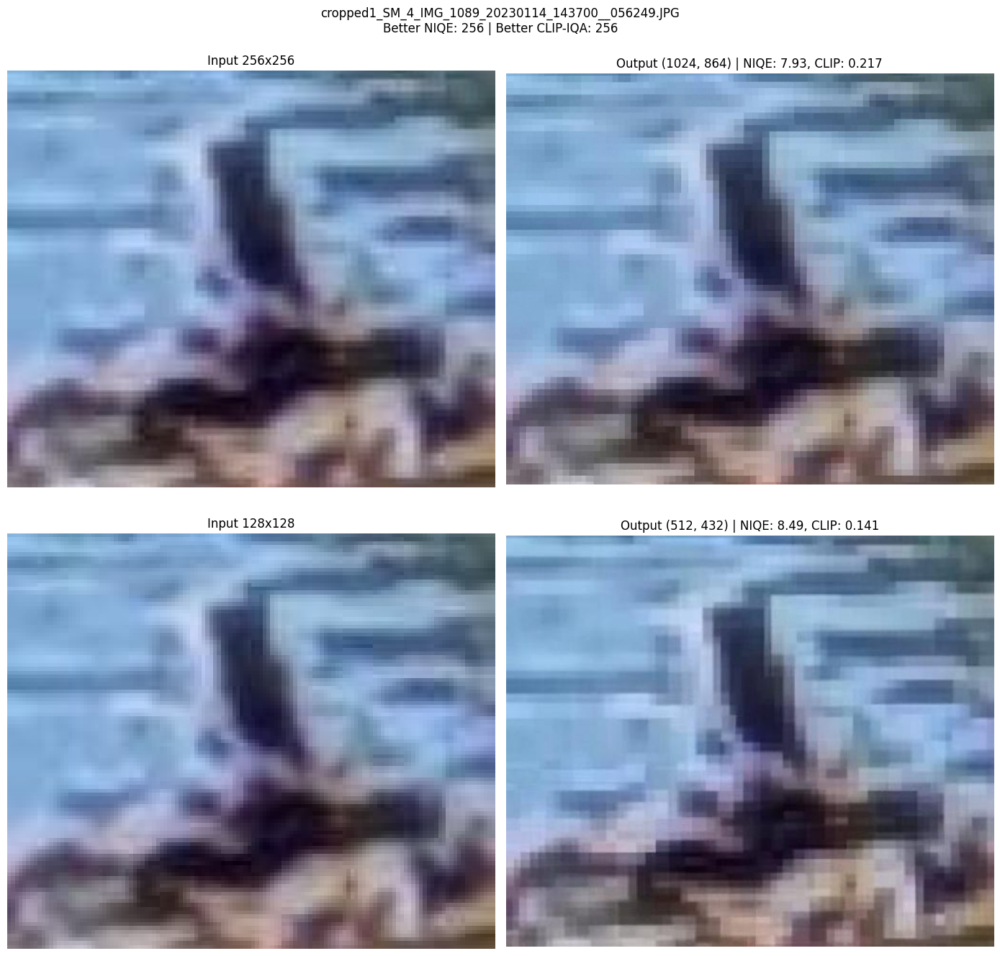

--------------------------------------------------------------------------------


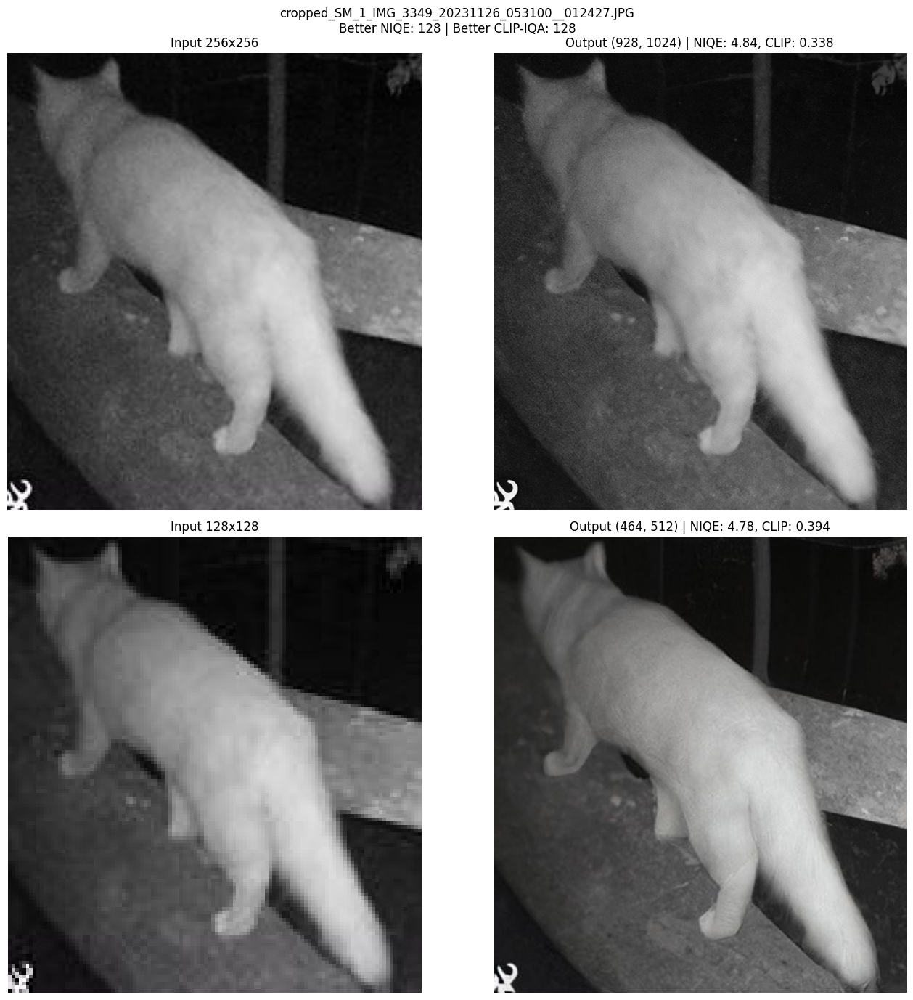

--------------------------------------------------------------------------------


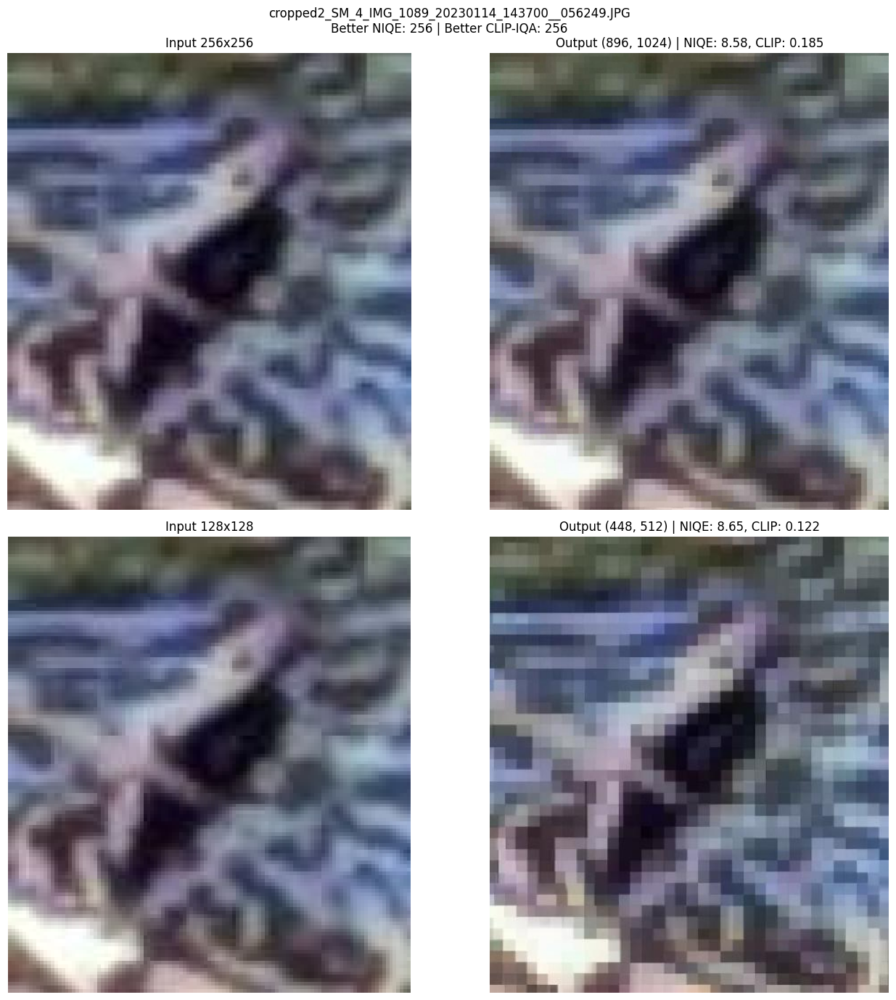

--------------------------------------------------------------------------------


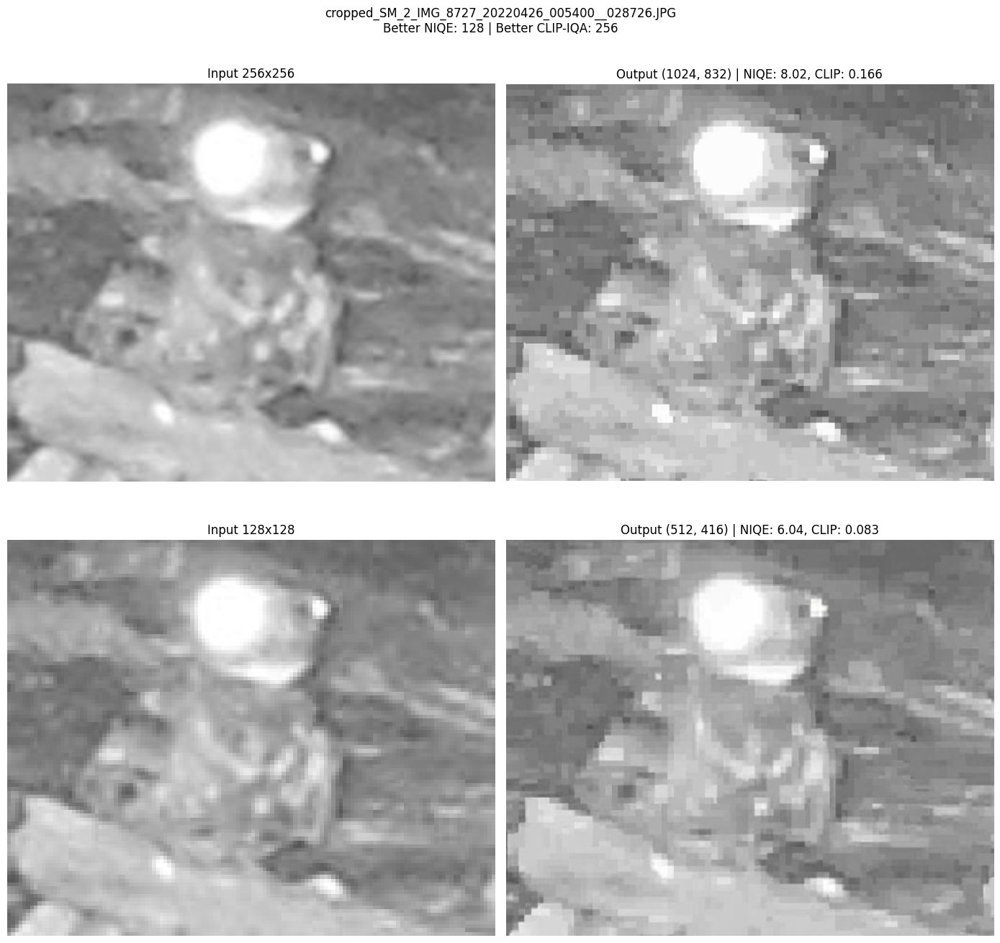

--------------------------------------------------------------------------------


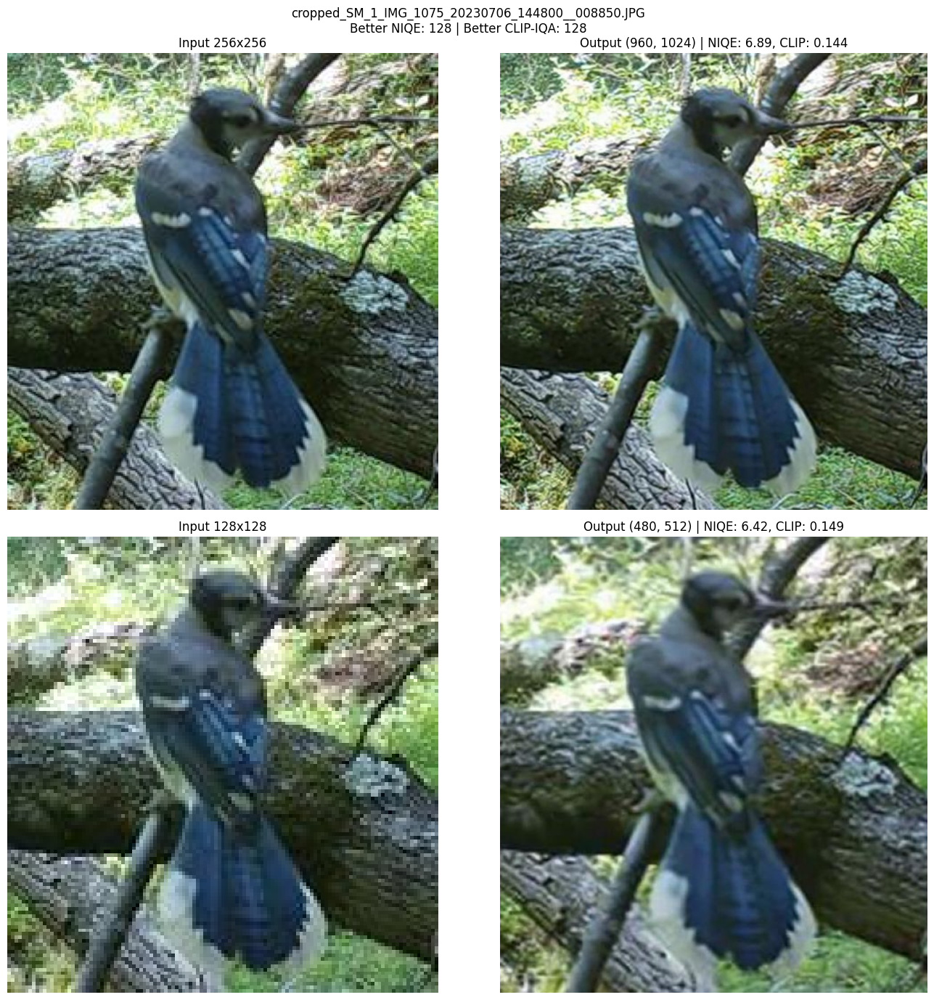

--------------------------------------------------------------------------------


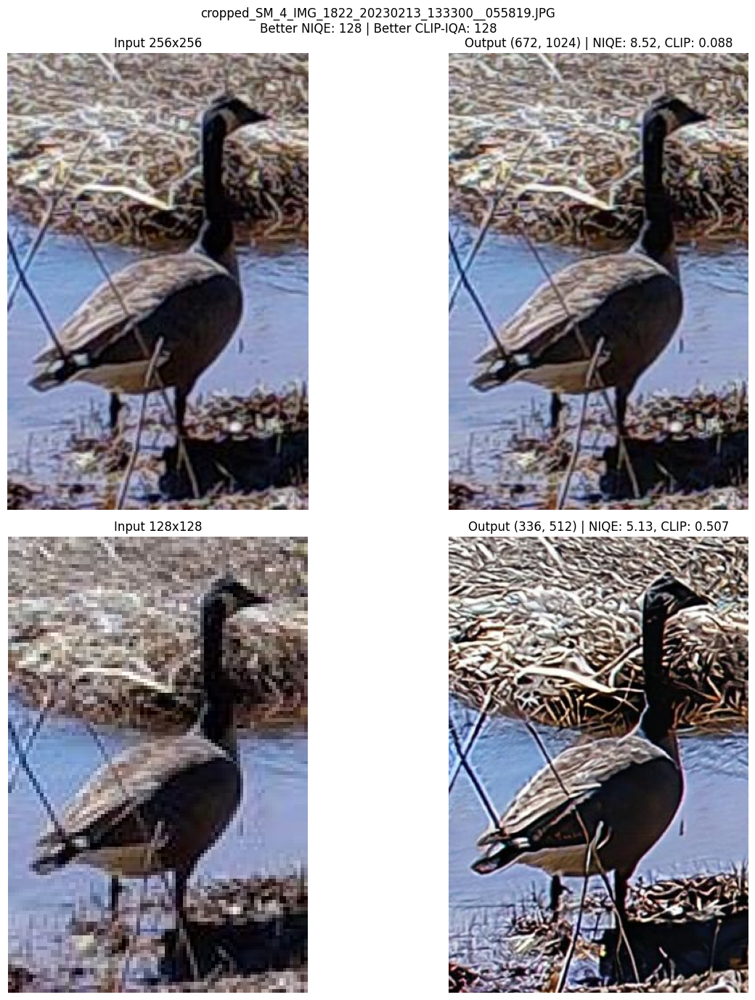

--------------------------------------------------------------------------------


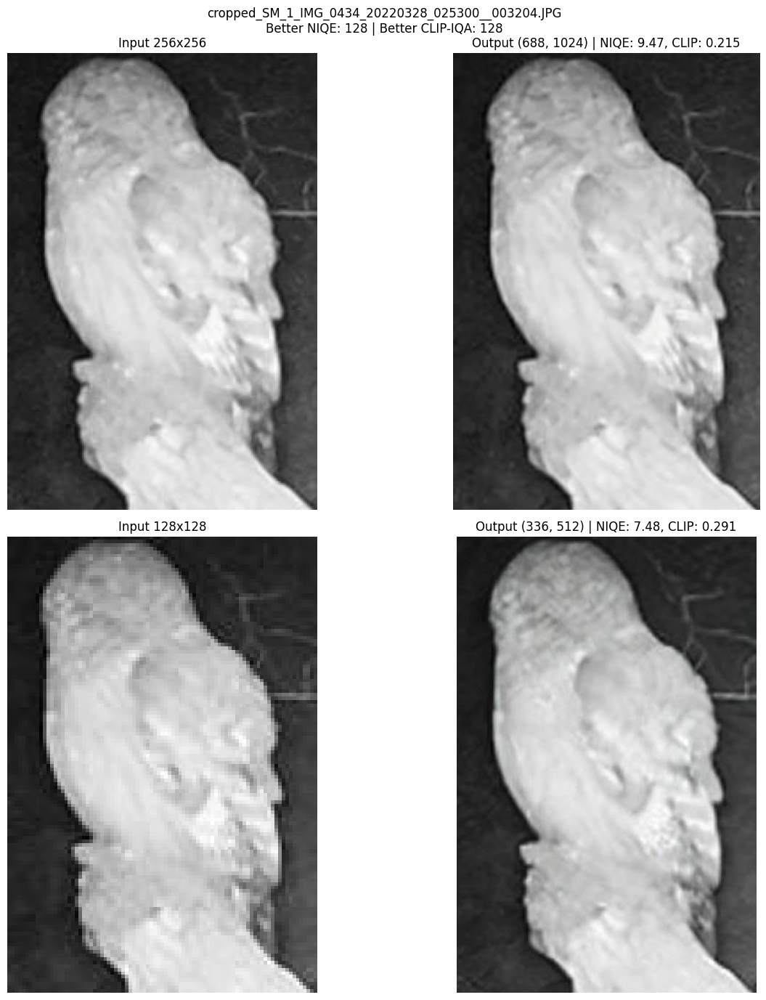

--------------------------------------------------------------------------------


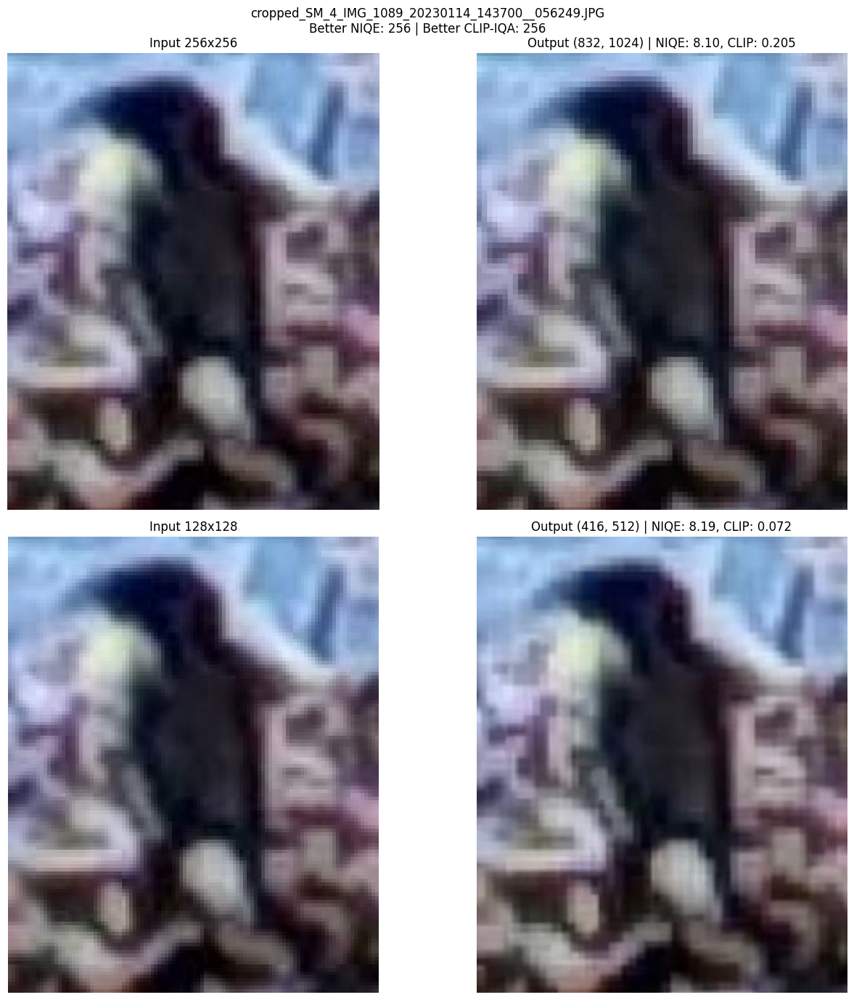

--------------------------------------------------------------------------------


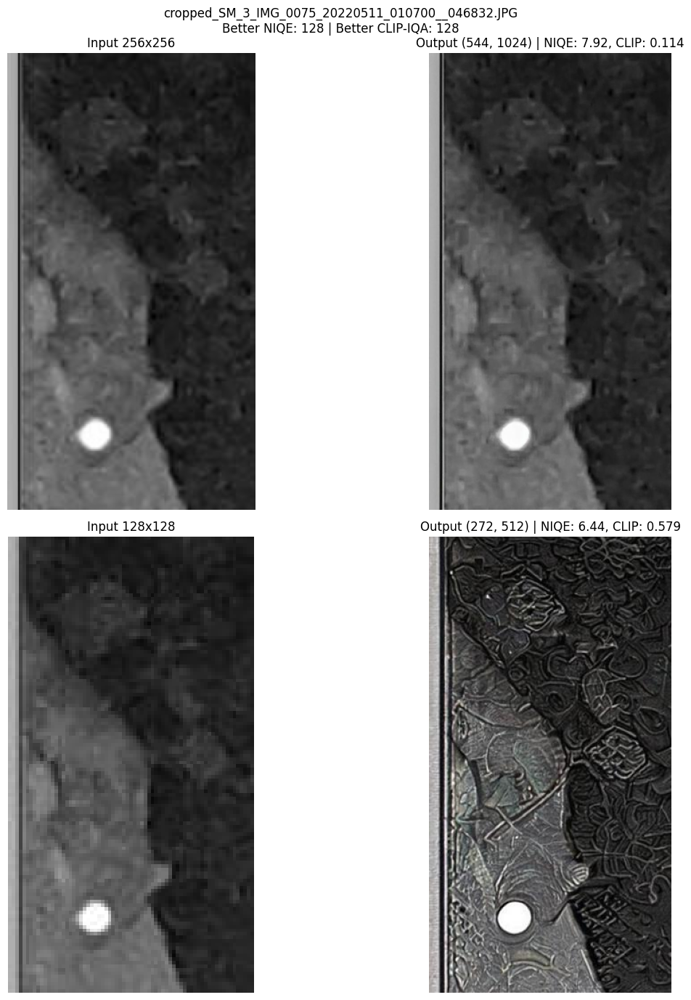

--------------------------------------------------------------------------------


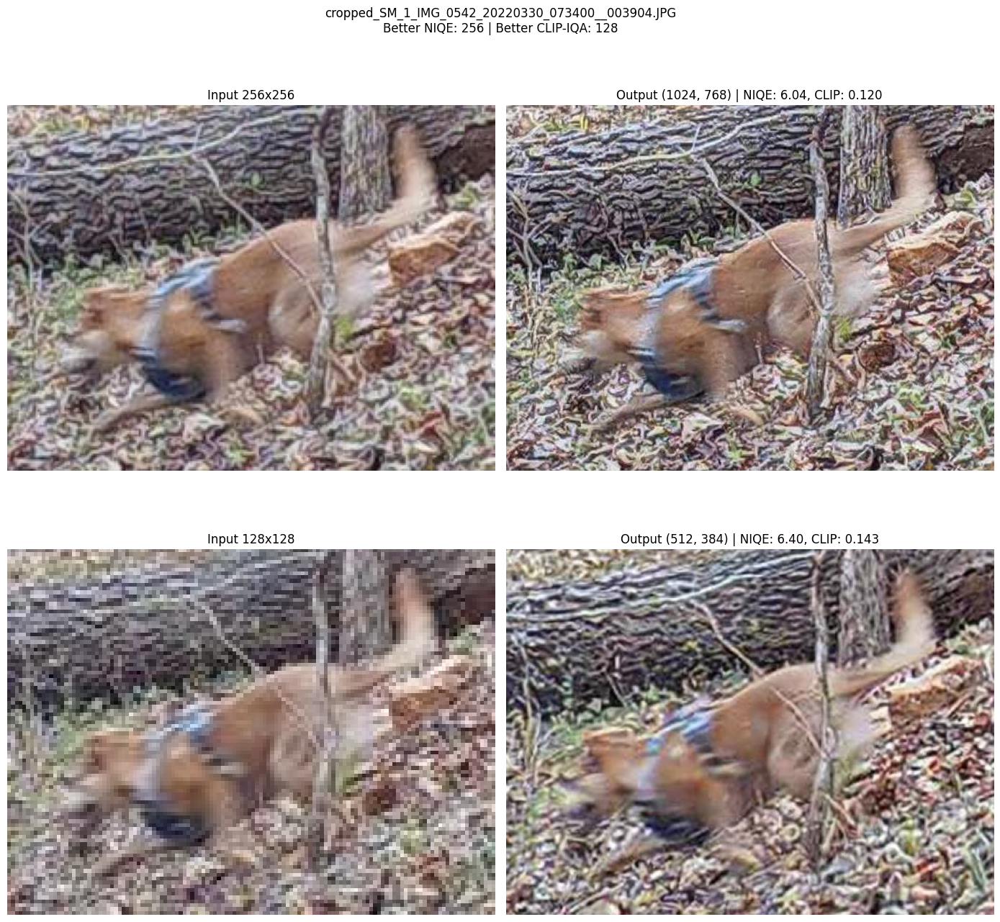

--------------------------------------------------------------------------------


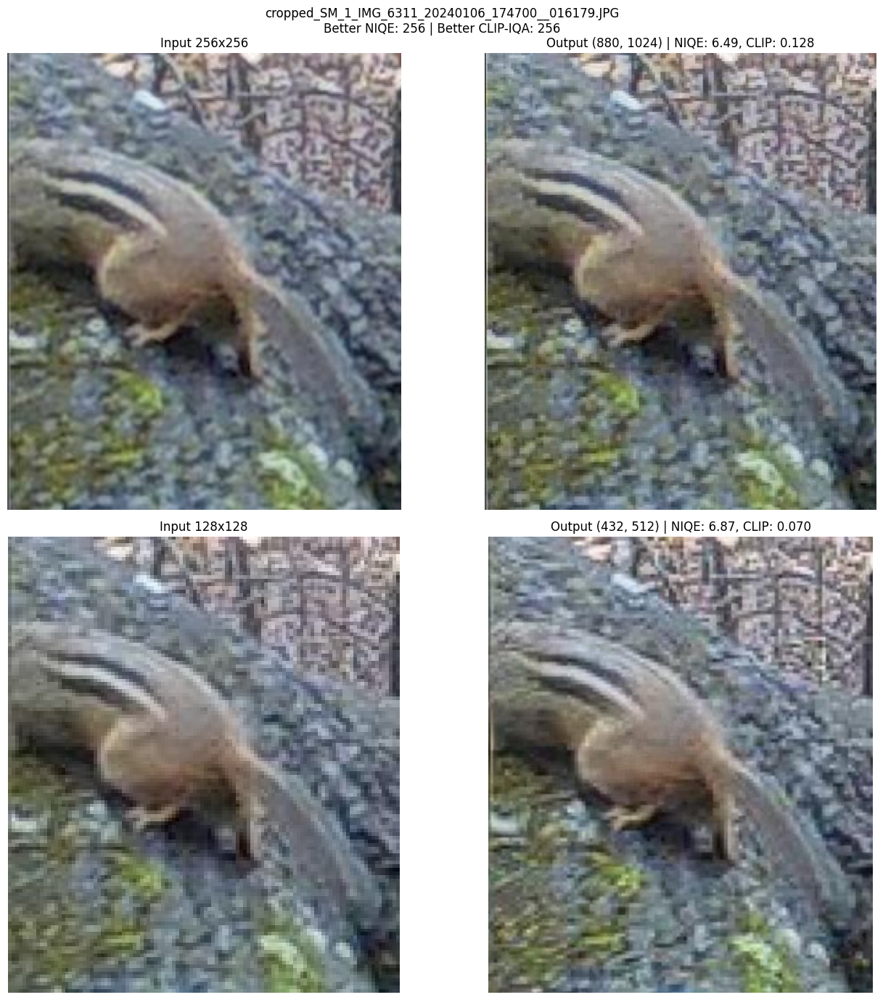

--------------------------------------------------------------------------------


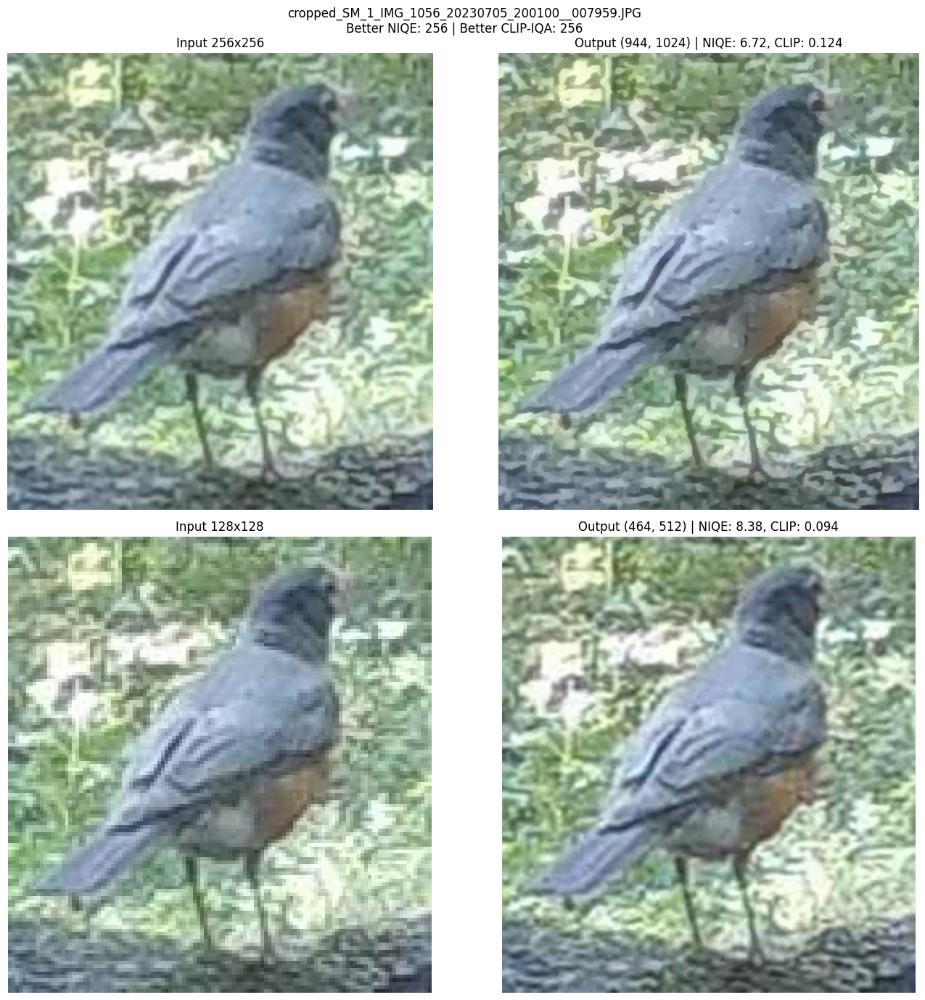

--------------------------------------------------------------------------------


In [21]:
import matplotlib.pyplot as plt
from PIL import Image
import os

for filename in os.listdir("input_images_256"):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        fig, axes = plt.subplots(2, 2, figsize=(14, 14))

        # Get the result for this file
        r = next((r for r in results if r['file'] == filename), None)

        # 256 pipeline
        img_in_256 = Image.open(f"input_images_256/{filename}")
        img_out_256 = Image.open(f"upscaled_images_256/upscaled_{filename}")

        axes[0, 0].imshow(img_in_256)
        axes[0, 0].set_title(f"Input 256x256")
        axes[0, 0].axis('off')

        axes[0, 1].imshow(img_out_256)
        axes[0, 1].set_title(f"Output {img_out_256.size} | NIQE: {r['out_256_niqe']:.2f}, CLIP: {r['out_256_clip']:.3f}")
        axes[0, 1].axis('off')

        # 128 pipeline
        img_in_128 = Image.open(f"input_images_128/{filename}")
        img_out_128 = Image.open(f"upscaled_images_128/upscaled_{filename}")

        axes[1, 0].imshow(img_in_128)
        axes[1, 0].set_title(f"Input 128x128")
        axes[1, 0].axis('off')

        axes[1, 1].imshow(img_out_128)
        axes[1, 1].set_title(f"Output {img_out_128.size} | NIQE: {r['out_128_niqe']:.2f}, CLIP: {r['out_128_clip']:.3f}")
        axes[1, 1].axis('off')

        # Determine winner
        niqe_winner = "256" if r['out_256_niqe'] < r['out_128_niqe'] else "128"
        clip_winner = "256" if r['out_256_clip'] > r['out_128_clip'] else "128"

        plt.suptitle(f"{filename}\nBetter NIQE: {niqe_winner} | Better CLIP-IQA: {clip_winner}", fontsize=12)
        plt.tight_layout()
        plt.show()
        print("-" * 80)

upscaled_images_max_quality

In [22]:
OUTPUT_DIR_MAX = "upscaled_images_max_quality"
os.makedirs(OUTPUT_DIR_MAX, exist_ok=True)

PROMPT = "high quality, detailed, sharp, 4k, ultra detailed, professional photography"
NEGATIVE_PROMPT = "blurry, low quality, artifacts, noise, pixelated, jpeg artifacts, distorted, deformed"

print("=== Processing with MAX QUALITY settings ===\n")

for filename in os.listdir("input_images_128"):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        print(f"Processing: {filename}")
        img = Image.open(f"input_images_128/{filename}").convert("RGB")

        upscaled = pipeline(
            prompt=PROMPT,
            negative_prompt=NEGATIVE_PROMPT,
            image=img,
            num_inference_steps=100,
            guidance_scale=12.0,
            noise_level=75,
        ).images[0]

        upscaled.save(f"{OUTPUT_DIR_MAX}/upscaled_{filename}")
        print(f"  {img.size} → {upscaled.size}")

print("\nDone!")

=== Processing with MAX QUALITY settings ===

Processing: cropped_SM_1_IMG_1481_20220422_122400__004262.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (126, 128) → (496, 512)
Processing: cropped1_SM_4_IMG_1089_20230114_143700__056249.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (128, 109) → (512, 432)
Processing: cropped_SM_1_IMG_3349_20231126_053100__012427.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (116, 128) → (464, 512)
Processing: cropped2_SM_4_IMG_1089_20230114_143700__056249.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (113, 128) → (448, 512)
Processing: cropped_SM_2_IMG_8727_20220426_005400__028726.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (128, 104) → (512, 416)
Processing: cropped_SM_1_IMG_1075_20230706_144800__008850.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (121, 128) → (480, 512)
Processing: cropped_SM_4_IMG_1822_20230213_133300__055819.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (84, 128) → (336, 512)
Processing: cropped_SM_1_IMG_0434_20220328_025300__003204.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (87, 128) → (336, 512)
Processing: cropped_SM_4_IMG_1089_20230114_143700__056249.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (104, 128) → (416, 512)
Processing: cropped_SM_3_IMG_0075_20220511_010700__046832.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (69, 128) → (272, 512)
Processing: cropped_SM_1_IMG_0542_20220330_073400__003904.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (128, 96) → (512, 384)
Processing: cropped_SM_1_IMG_6311_20240106_174700__016179.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (110, 128) → (432, 512)
Processing: cropped_SM_1_IMG_1056_20230705_200100__007959.JPG


  0%|          | 0/100 [00:00<?, ?it/s]

  (119, 128) → (464, 512)

Done!


In [23]:
# Evaluate max quality outputs
print("=== Evaluating Max Quality Outputs ===\n")

results_max = []

for filename in os.listdir("input_images_128"):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        out_old = f"upscaled_images_128/upscaled_{filename}"
        out_max = f"{OUTPUT_DIR_MAX}/upscaled_{filename}"

        results_max.append({
            'file': filename,
            'old_niqe': niqe(out_old).item(),
            'max_niqe': niqe(out_max).item(),
            'old_clip': clipiqa(out_old).item(),
            'max_clip': clipiqa(out_max).item(),
        })
        print(f"Evaluated: {filename}")

# Summary
print(f"\n{'='*85}")
print(f"{'File':<45} {'Old NIQE':<10} {'Max NIQE':<10} {'Old CLIP':<10} {'Max CLIP':<10}")
print(f"{'='*85}")

for r in results_max:
    print(f"{r['file']:<45} {r['old_niqe']:.2f}      {r['max_niqe']:.2f}      {r['old_clip']:.3f}      {r['max_clip']:.3f}")

avg_old_niqe = sum(r['old_niqe'] for r in results_max) / len(results_max)
avg_max_niqe = sum(r['max_niqe'] for r in results_max) / len(results_max)
avg_old_clip = sum(r['old_clip'] for r in results_max) / len(results_max)
avg_max_clip = sum(r['max_clip'] for r in results_max) / len(results_max)

print(f"\n{'='*85}")
print("AVERAGES:")
print(f"  Old settings: NIQE={avg_old_niqe:.2f}, CLIP-IQA={avg_old_clip:.3f}")
print(f"  Max quality:  NIQE={avg_max_niqe:.2f}, CLIP-IQA={avg_max_clip:.3f}")

=== Evaluating Max Quality Outputs ===

Evaluated: cropped_SM_1_IMG_1481_20220422_122400__004262.JPG
Evaluated: cropped1_SM_4_IMG_1089_20230114_143700__056249.JPG
Evaluated: cropped_SM_1_IMG_3349_20231126_053100__012427.JPG
Evaluated: cropped2_SM_4_IMG_1089_20230114_143700__056249.JPG
Evaluated: cropped_SM_2_IMG_8727_20220426_005400__028726.JPG
Evaluated: cropped_SM_1_IMG_1075_20230706_144800__008850.JPG
Evaluated: cropped_SM_4_IMG_1822_20230213_133300__055819.JPG
Evaluated: cropped_SM_1_IMG_0434_20220328_025300__003204.JPG
Evaluated: cropped_SM_4_IMG_1089_20230114_143700__056249.JPG
Evaluated: cropped_SM_3_IMG_0075_20220511_010700__046832.JPG
Evaluated: cropped_SM_1_IMG_0542_20220330_073400__003904.JPG
Evaluated: cropped_SM_1_IMG_6311_20240106_174700__016179.JPG
Evaluated: cropped_SM_1_IMG_1056_20230705_200100__007959.JPG

File                                          Old NIQE   Max NIQE   Old CLIP   Max CLIP  
cropped_SM_1_IMG_1481_20220422_122400__004262.JPG 5.12      6.02      0.64

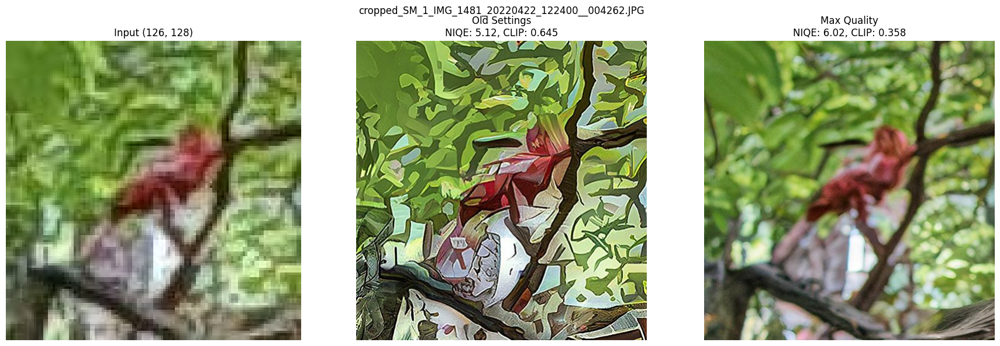

--------------------------------------------------------------------------------


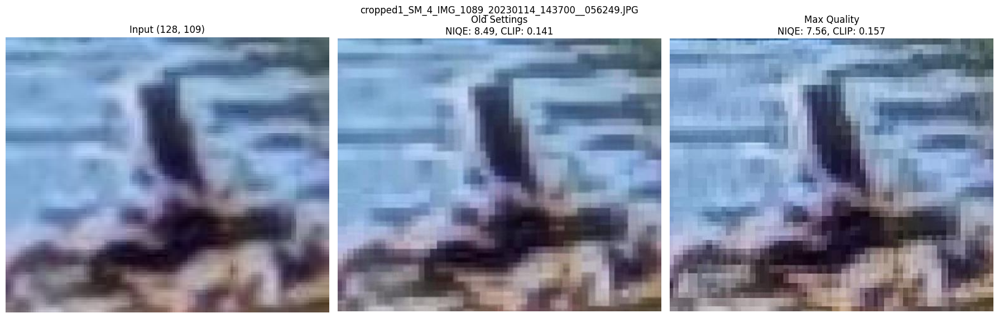

--------------------------------------------------------------------------------


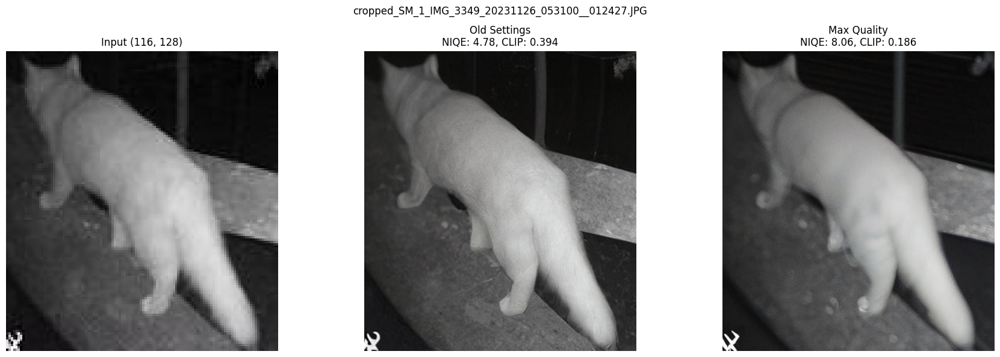

--------------------------------------------------------------------------------


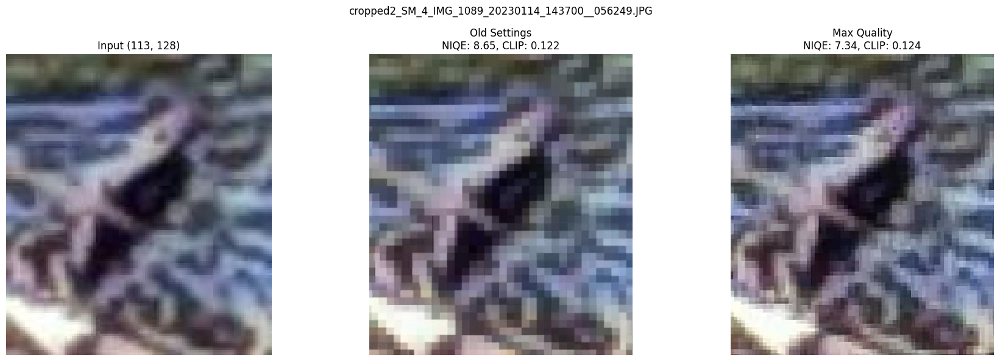

--------------------------------------------------------------------------------


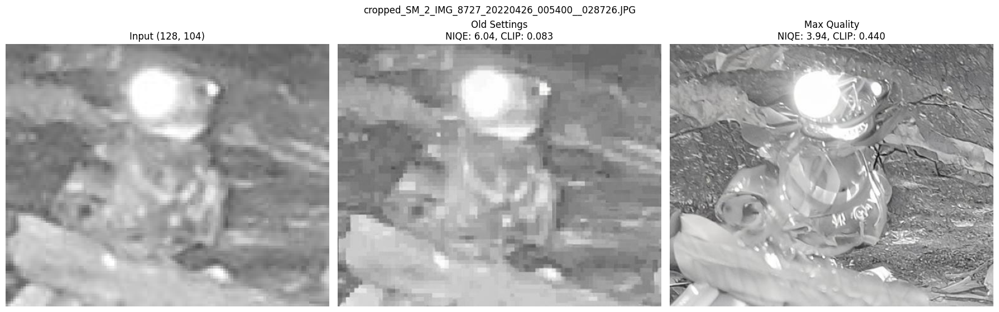

--------------------------------------------------------------------------------


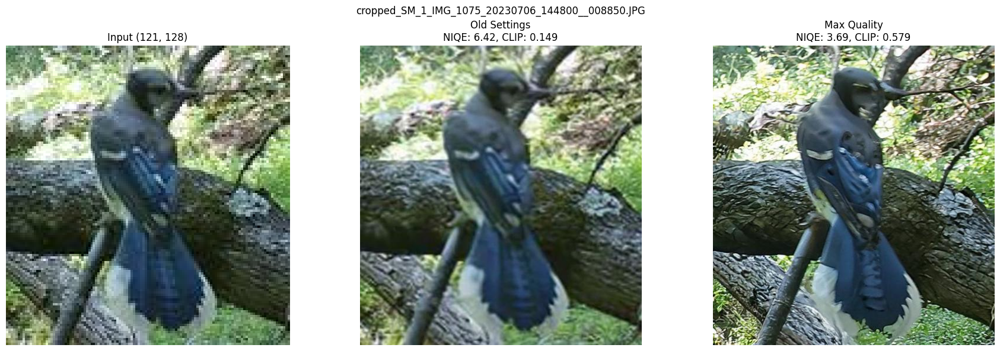

--------------------------------------------------------------------------------


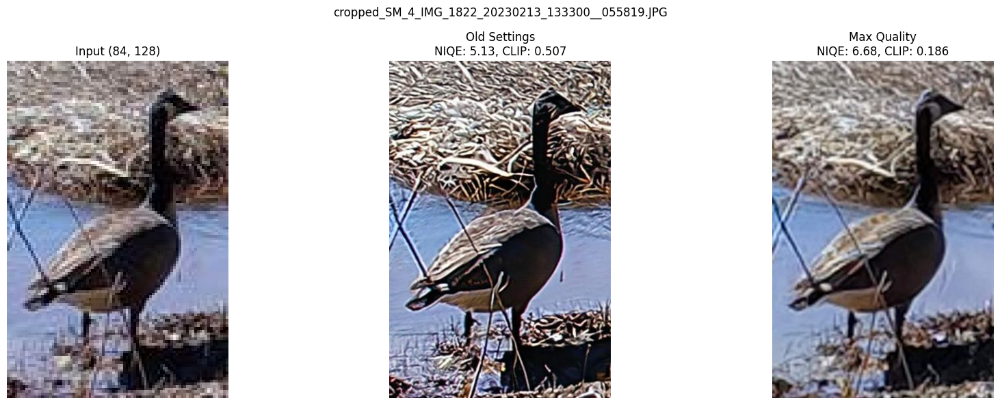

--------------------------------------------------------------------------------


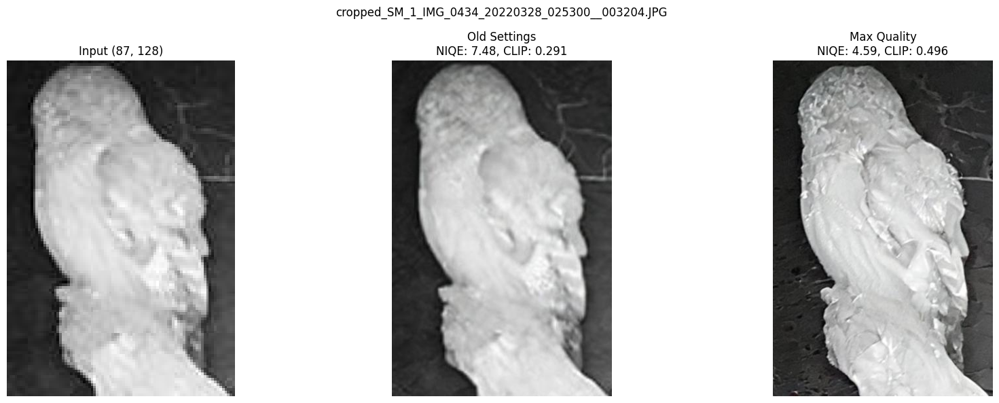

--------------------------------------------------------------------------------


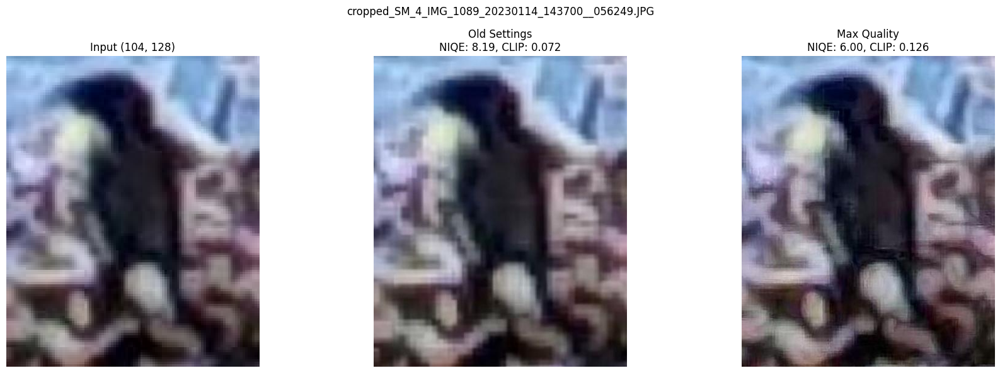

--------------------------------------------------------------------------------


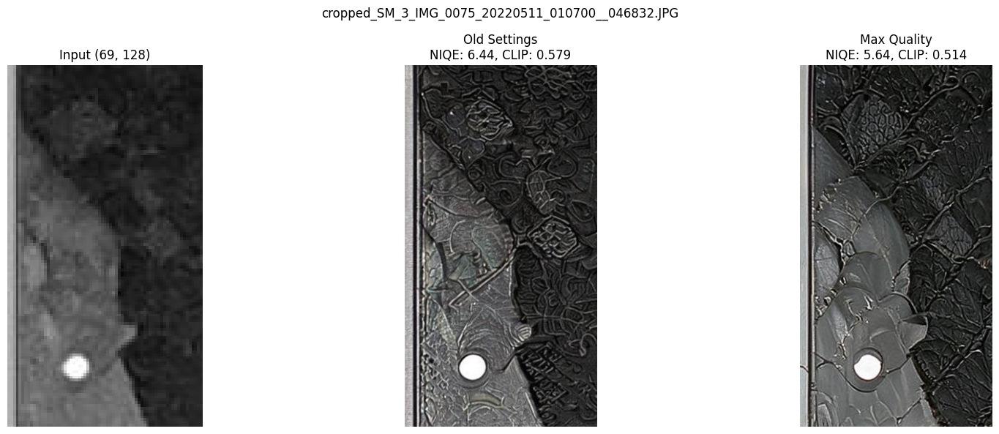

--------------------------------------------------------------------------------


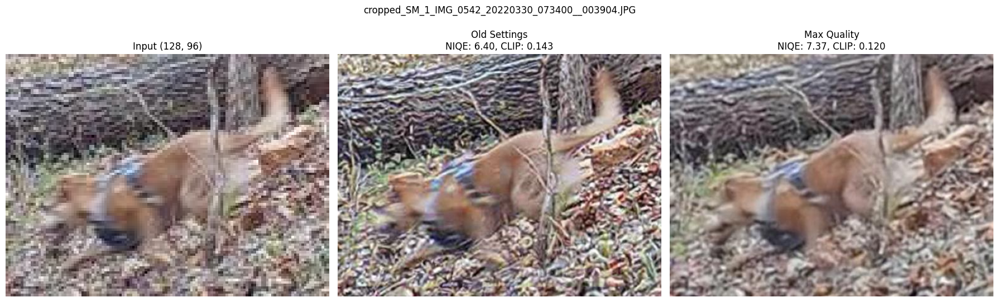

--------------------------------------------------------------------------------


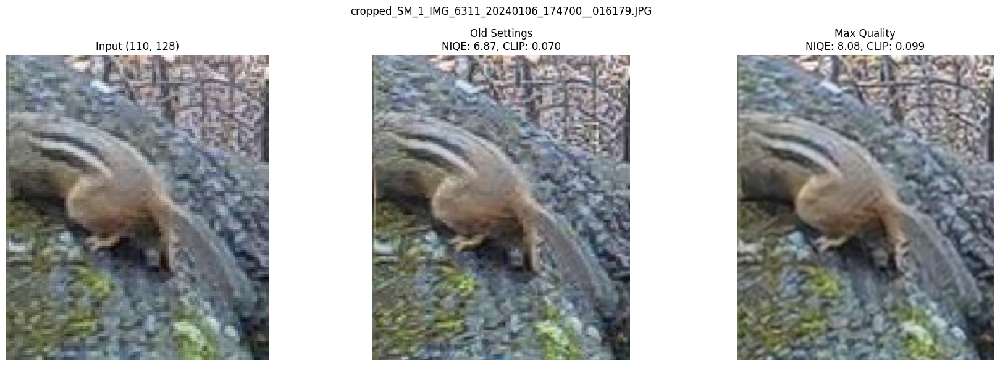

--------------------------------------------------------------------------------


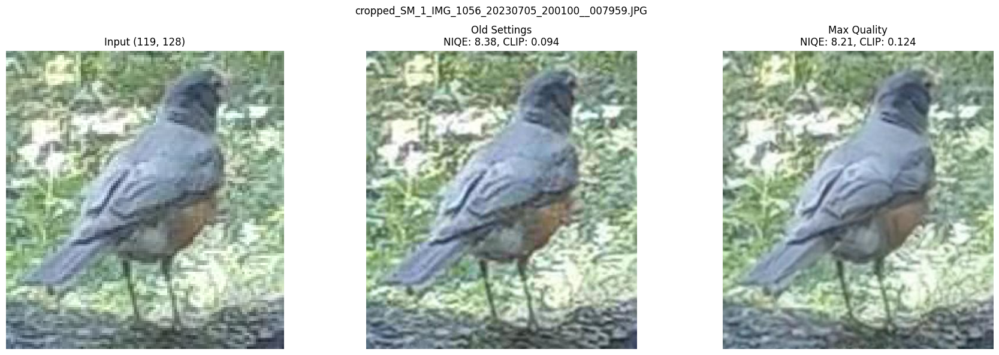

--------------------------------------------------------------------------------


In [24]:
for filename in os.listdir("input_images_128"):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))

        r = next((r for r in results_max if r['file'] == filename), None)

        # Input
        img_in = Image.open(f"input_images_128/{filename}")
        axes[0].imshow(img_in)
        axes[0].set_title(f"Input {img_in.size}")
        axes[0].axis('off')

        # Old settings
        img_old = Image.open(f"upscaled_images_128/upscaled_{filename}")
        axes[1].imshow(img_old)
        axes[1].set_title(f"Old Settings\nNIQE: {r['old_niqe']:.2f}, CLIP: {r['old_clip']:.3f}")
        axes[1].axis('off')

        # Max quality
        img_max = Image.open(f"{OUTPUT_DIR_MAX}/upscaled_{filename}")
        axes[2].imshow(img_max)
        axes[2].set_title(f"Max Quality\nNIQE: {r['max_niqe']:.2f}, CLIP: {r['max_clip']:.3f}")
        axes[2].axis('off')

        plt.suptitle(filename, fontsize=12)
        plt.tight_layout()
        plt.show()
        print("-" * 80)

In [25]:
import shutil
from google.colab import files

# Zip and download max quality results
shutil.make_archive("max_quality_results", 'zip', "upscaled_images_max_quality")
files.download("max_quality_results.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [26]:
import shutil
from google.colab import files

# Create a folder with everything
os.makedirs("all_results", exist_ok=True)
shutil.copytree("input_images_128", "all_results/input_128", dirs_exist_ok=True)
shutil.copytree("input_images_256", "all_results/input_256", dirs_exist_ok=True)
shutil.copytree("upscaled_images_128", "all_results/upscaled_128", dirs_exist_ok=True)
shutil.copytree("upscaled_images_256", "all_results/upscaled_256", dirs_exist_ok=True)
shutil.copytree("upscaled_images_max_quality", "all_results/upscaled_max_quality", dirs_exist_ok=True)

# Zip and download
shutil.make_archive("all_results", 'zip', "all_results")
files.download("all_results.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Evaluating results

In [27]:
# Evaluate max quality outputs
print("=== Evaluating Max Quality Outputs ===\n")

results_max = []

for filename in os.listdir("input_images_128"):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        out_old = f"upscaled_images_128/upscaled_{filename}"
        out_max = f"upscaled_images_max_quality/upscaled_{filename}"

        results_max.append({
            'file': filename,
            'old_niqe': niqe(out_old).item(),
            'max_niqe': niqe(out_max).item(),
            'old_clip': clipiqa(out_old).item(),
            'max_clip': clipiqa(out_max).item(),
        })
        print(f"Evaluated: {filename}")

print("\nDone! results_max created")

=== Evaluating Max Quality Outputs ===

Evaluated: cropped_SM_1_IMG_1481_20220422_122400__004262.JPG
Evaluated: cropped1_SM_4_IMG_1089_20230114_143700__056249.JPG
Evaluated: cropped_SM_1_IMG_3349_20231126_053100__012427.JPG
Evaluated: cropped2_SM_4_IMG_1089_20230114_143700__056249.JPG
Evaluated: cropped_SM_2_IMG_8727_20220426_005400__028726.JPG
Evaluated: cropped_SM_1_IMG_1075_20230706_144800__008850.JPG
Evaluated: cropped_SM_4_IMG_1822_20230213_133300__055819.JPG
Evaluated: cropped_SM_1_IMG_0434_20220328_025300__003204.JPG
Evaluated: cropped_SM_4_IMG_1089_20230114_143700__056249.JPG
Evaluated: cropped_SM_3_IMG_0075_20220511_010700__046832.JPG
Evaluated: cropped_SM_1_IMG_0542_20220330_073400__003904.JPG
Evaluated: cropped_SM_1_IMG_6311_20240106_174700__016179.JPG
Evaluated: cropped_SM_1_IMG_1056_20230705_200100__007959.JPG

Done! results_max created


In [28]:
import pandas as pd
from google.colab import files

df = pd.DataFrame(results_max)
df.to_csv("metrics_results.csv", index=False)
files.download("metrics_results.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Visual comparison
import matplotlib.pyplot as plt

for filename in os.listdir("input_images_256")[:3]:  # Show first 3 images
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        fig, axes = plt.subplots(2, 2, figsize=(12, 12))

        # 256 input/output
        axes[0, 0].imshow(Image.open(f"input_images_256/{filename}"))
        axes[0, 0].set_title(f"Input 256x256")
        axes[0, 0].axis('off')

        axes[0, 1].imshow(Image.open(f"upscaled_images_256/upscaled_{filename}"))
        axes[0, 1].set_title(f"Output from 256 → {Image.open(f'upscaled_images_256/upscaled_{filename}').size}")
        axes[0, 1].axis('off')

        # 128 input/output
        axes[1, 0].imshow(Image.open(f"input_images_128/{filename}"))
        axes[1, 0].set_title(f"Input 128x128")
        axes[1, 0].axis('off')

        axes[1, 1].imshow(Image.open(f"upscaled_images_128/upscaled_{filename}"))
        axes[1, 1].set_title(f"Output from 128 → {Image.open(f'upscaled_images_128/upscaled_{filename}').size}")
        axes[1, 1].axis('off')

        plt.suptitle(filename, fontsize=14)
        plt.tight_layout()
        plt.show()

## 7. Visualize Results

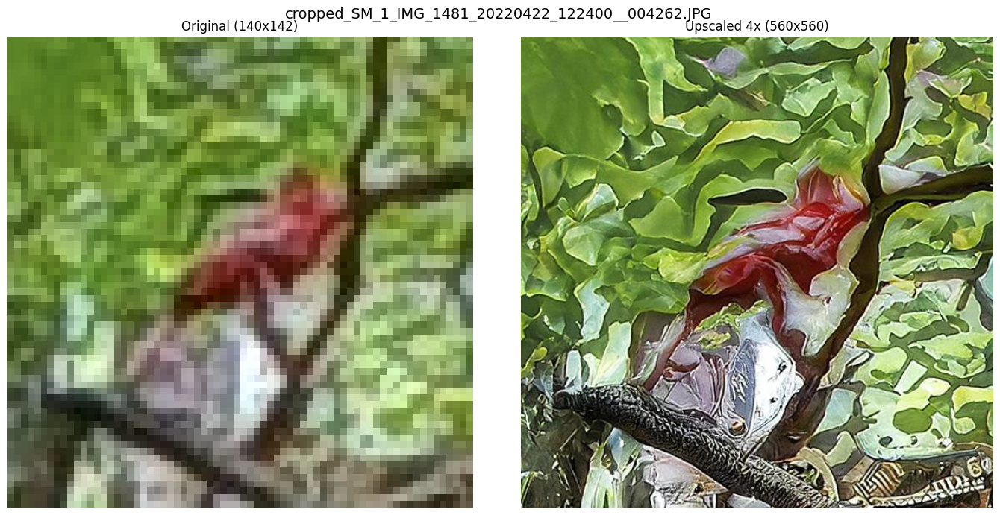

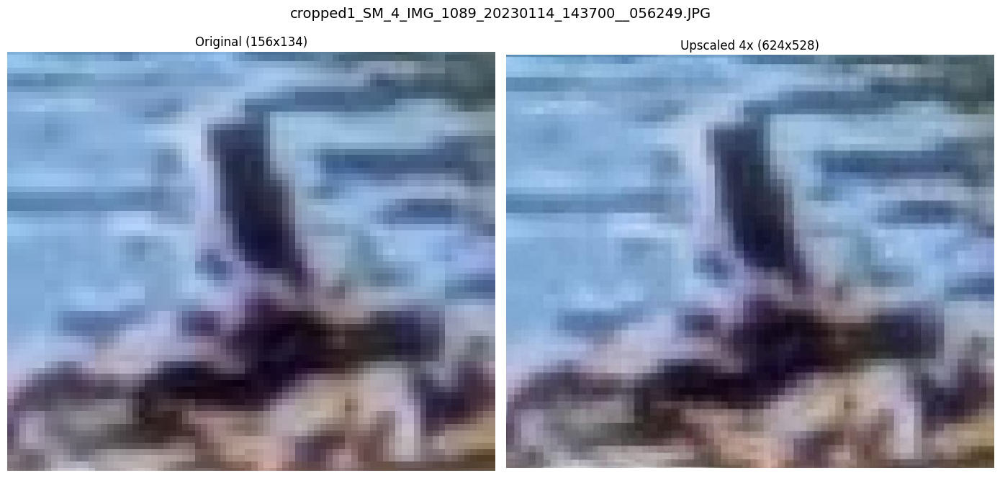

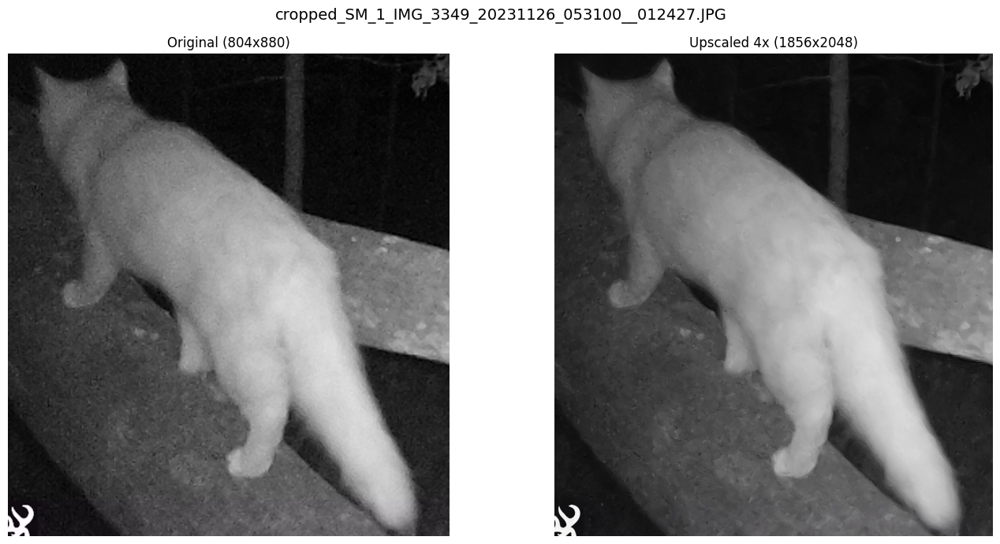

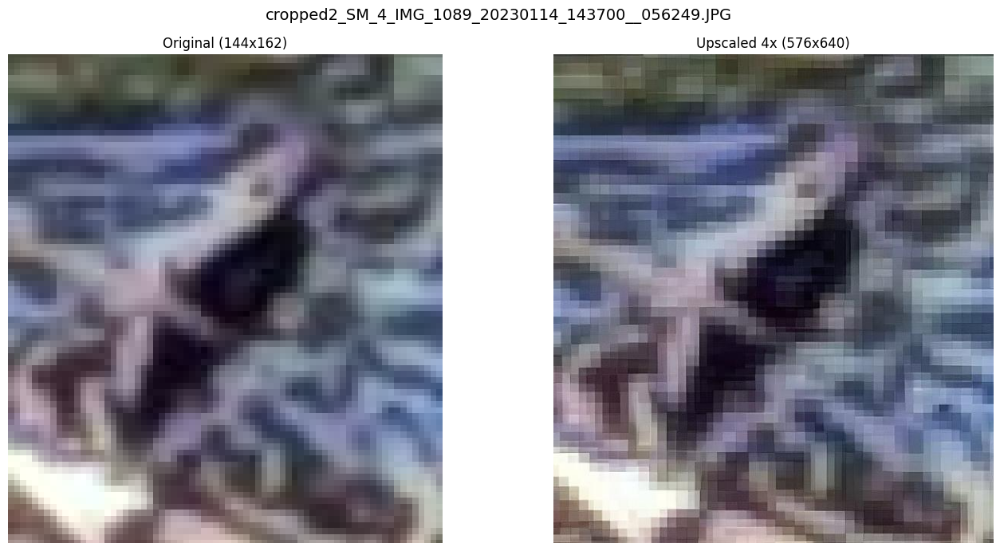

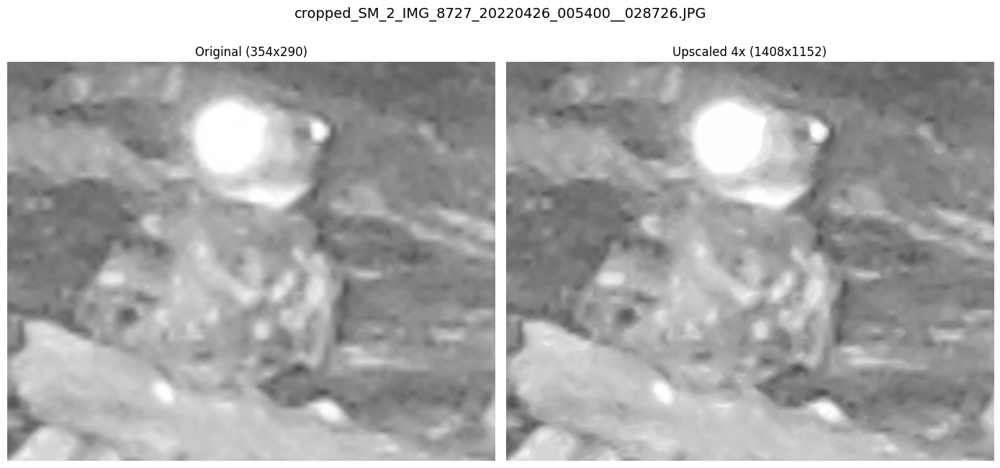

...

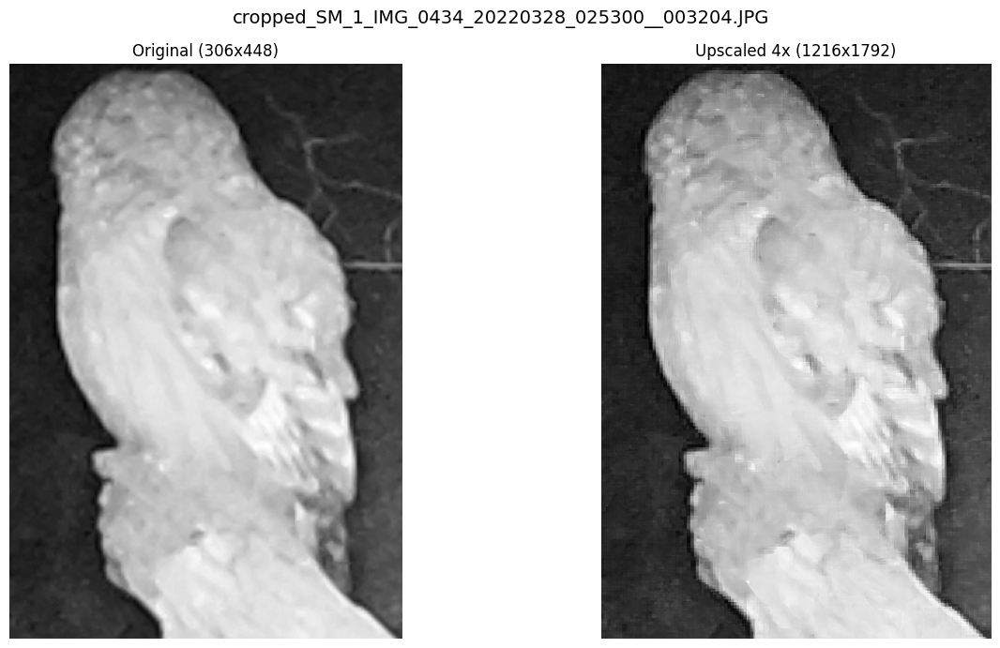

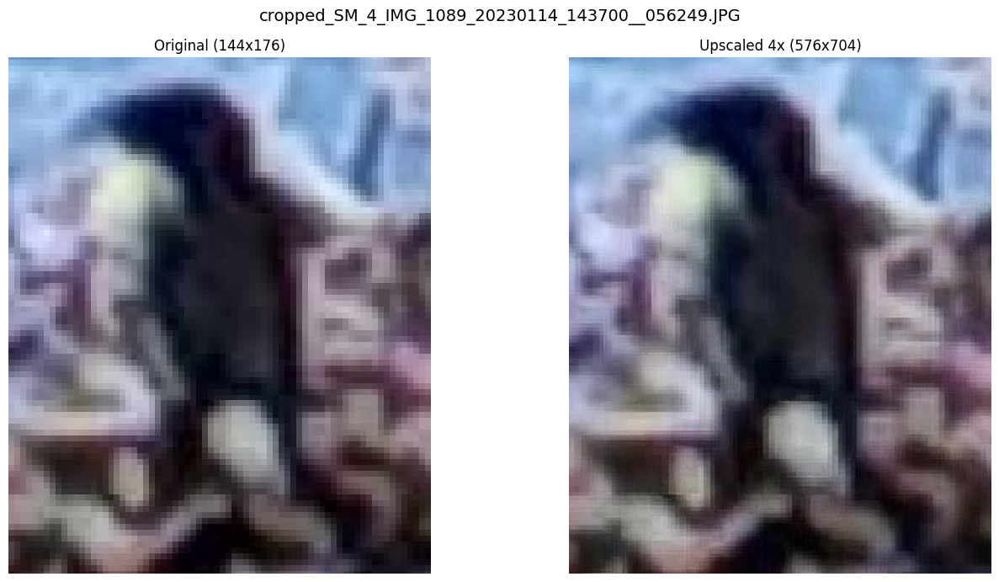

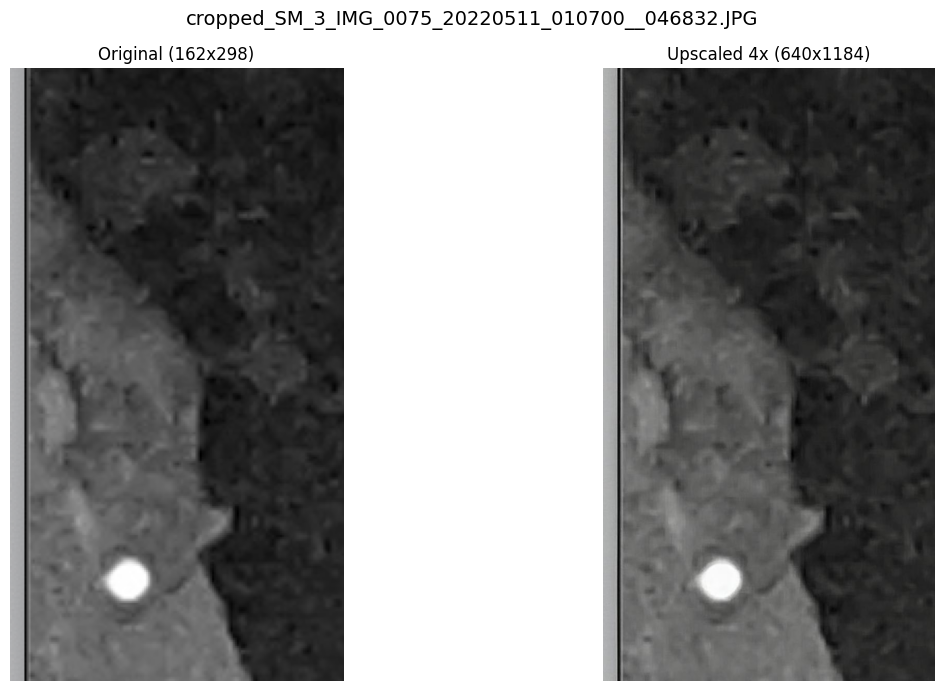

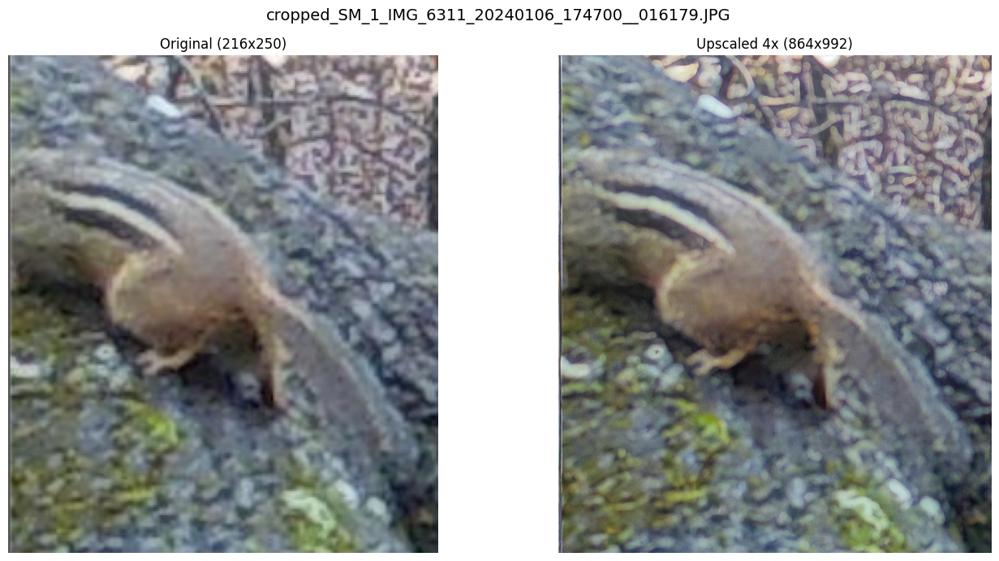

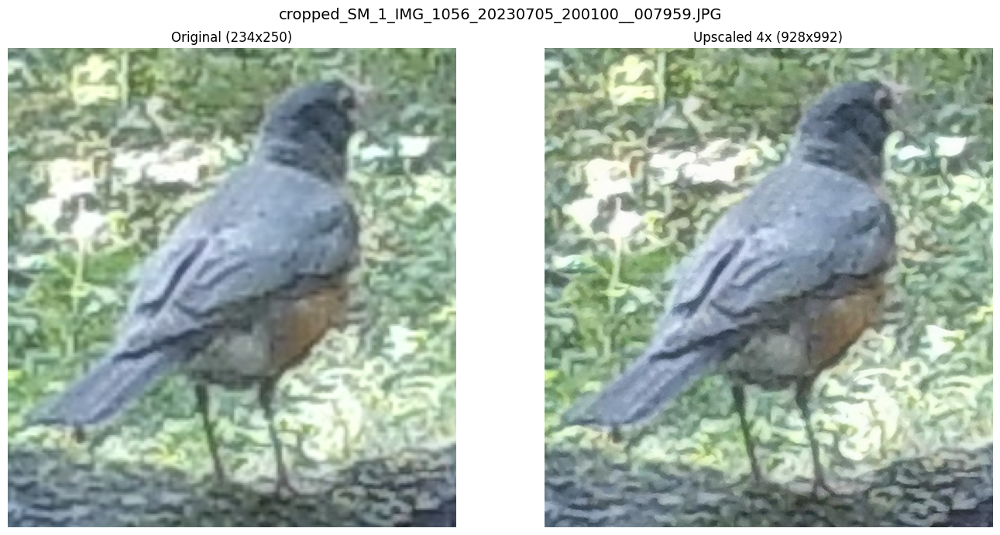

In [10]:
# Display before/after comparison for each processed image
def show_comparison(original_path, upscaled_path, title=""):
    fig, axes = plt.subplots(1, 2, figsize=(14, 7))

    # Original
    original = Image.open(original_path)
    axes[0].imshow(original)
    axes[0].set_title(f"Original ({original.size[0]}x{original.size[1]})")
    axes[0].axis('off')

    # Upscaled
    upscaled = Image.open(upscaled_path)
    axes[1].imshow(upscaled)
    axes[1].set_title(f"Upscaled 4x ({upscaled.size[0]}x{upscaled.size[1]})")
    axes[1].axis('off')

    plt.suptitle(title, fontsize=14)
    plt.tight_layout()
    plt.show()

# Show comparisons
for result in results:
    if result['status'] == 'success':
        original_path = os.path.join(INPUT_DIR, result['filename'])
        upscaled_path = os.path.join(OUTPUT_DIR, f"upscaled_{result['filename']}")
        show_comparison(original_path, upscaled_path, title=result['filename'])

## 8. Download Results

In [11]:
# Create a zip file of all upscaled images
import shutil

zip_filename = "upscaled_images"
shutil.make_archive(zip_filename, 'zip', OUTPUT_DIR)

print(f"Created: {zip_filename}.zip")
print("\nClick below to download:")
files.download(f"{zip_filename}.zip")

Created: upscaled_images.zip

Click below to download:


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 9. Single Image Test (Optional)

Use this section to test upscaling on a single image with custom parameters.

Test image size: (128, 128)


  0%|          | 0/50 [00:00<?, ?it/s]

Upscaled size: (512, 512)


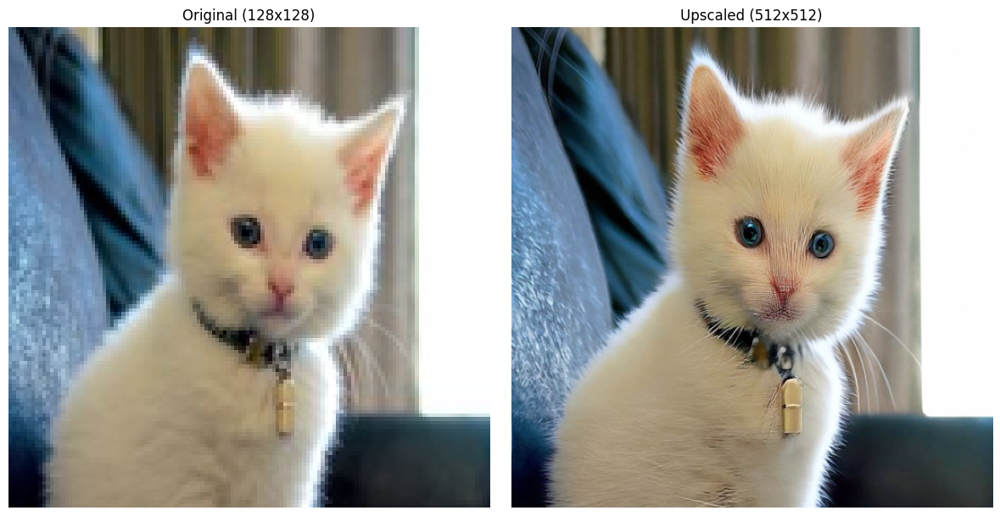

In [9]:
# Test with a sample image from the web
url = "https://huggingface.co/datasets/hf-internal-testing/diffusers-images/resolve/main/sd2-upscale/low_res_cat.png"
response = requests.get(url)
test_image = Image.open(BytesIO(response.content)).convert("RGB")
test_image = test_image.resize((128, 128))  # Ensure small size for testing

print(f"Test image size: {test_image.size}")

# Upscale
prompt = "a white cat, high quality, detailed fur, sharp"
upscaled = pipeline(
    prompt=prompt,
    image=test_image,
    num_inference_steps=50,
    guidance_scale=9.0,
    noise_level=20
).images[0]

print(f"Upscaled size: {upscaled.size}")

# Display
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(test_image)
axes[0].set_title(f"Original ({test_image.size[0]}x{test_image.size[1]})")
axes[0].axis('off')
axes[1].imshow(upscaled)
axes[1].set_title(f"Upscaled ({upscaled.size[0]}x{upscaled.size[1]})")
axes[1].axis('off')
plt.tight_layout()
plt.show()

In [10]:
for filename in os.listdir("input_images"):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        img = Image.open(f"input_images/{filename}")
        w, h = img.size
        print(f"{filename}: {w} x {h} ({img.mode}, {w*h/1e6:.2f} MP)")

cropped_SM_2_IMG_8727_20220426_005400__028726.JPG: 354 x 290 (RGBA, 0.10 MP)
cropped_SM_4_IMG_1822_20230213_133300__055819.JPG: 266 x 402 (RGBA, 0.11 MP)
cropped2_SM_4_IMG_1089_20230114_143700__056249.JPG: 144 x 162 (RGBA, 0.02 MP)
cropped_SM_3_IMG_0075_20220511_010700__046832.JPG: 162 x 298 (RGBA, 0.05 MP)
cropped_SM_1_IMG_1481_20220422_122400__004262.JPG: 140 x 142 (RGBA, 0.02 MP)
cropped_SM_1_IMG_3349_20231126_053100__012427.JPG: 804 x 880 (RGBA, 0.71 MP)
cropped_SM_1_IMG_1075_20230706_144800__008850.JPG: 680 x 718 (RGBA, 0.49 MP)
cropped_SM_1_IMG_1056_20230705_200100__007959.JPG: 234 x 250 (RGBA, 0.06 MP)
cropped1_SM_4_IMG_1089_20230114_143700__056249.JPG: 156 x 134 (RGBA, 0.02 MP)
cropped_SM_4_IMG_1089_20230114_143700__056249.JPG: 144 x 176 (RGBA, 0.03 MP)
cropped_SM_1_IMG_0542_20220330_073400__003904.JPG: 592 x 444 (RGBA, 0.26 MP)
cropped_SM_1_IMG_6311_20240106_174700__016179.JPG: 216 x 250 (RGBA, 0.05 MP)
cropped_SM_1_IMG_0434_20220328_025300__003204.JPG: 306 x 448 (RGBA, 0.14 M

In [11]:
!pip install -q pyiqa

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 74.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.4/129.4 kB 14.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.8/46.8 kB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.0/178.0 kB 21.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 276.2/276.2 kB 32.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 107.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 333.2/333.2 kB 36.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.4/59.4 MB 16.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.6/59.6 kB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 299.4/299.4 kB 34.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 226.4/226.4 kB 26.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [12]:
import pyiqa
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"

niqe = pyiqa.create_metric('niqe', device=device)
brisque = pyiqa.create_metric('brisque', device=device)
clipiqa = pyiqa.create_metric('clipiqa', device=device)

Downloading: "https://huggingface.co/chaofengc/IQA-PyTorch-Weights/resolve/main/niqe_modelparameters.mat" to /root/.cache/torch/hub/pyiqa/niqe_modelparameters.mat



100%|██████████| 8.15k/8.15k [00:00<00:00, 22.0MB/s]


Downloading: "https://huggingface.co/chaofengc/IQA-PyTorch-Weights/resolve/main/brisque_svm_weights.pth" to /root/.cache/torch/hub/pyiqa/brisque_svm_weights.pth



100%|██████████| 112k/112k [00:00<00:00, 51.1MB/s]
100%|████████████████████████████████████████| 244M/244M [00:01<00:00, 152MiB/s]


In [ ]:
# Test on one image
input_path = "input_images/your_image.jpg"  # change to your filename
output_path = "upscaled_images/upscaled_your_image.jpg"

print("INPUT:")
print(f"  NIQE: {niqe(input_path).item():.4f}")
print(f"  CLIP-IQA: {clipiqa(input_path).item():.4f}")

print("\nOUTPUT:")
print(f"  NIQE: {niqe(output_path).item():.4f}")
print(f"  CLIP-IQA: {clipiqa(output_path).item():.4f}")

---

## Tips for Best Results

1. **Prompt matters**: Use descriptive prompts that match your image content (e.g., "a landscape photo, mountains, detailed" for nature images)

2. **Noise level**: Lower values (10-30) preserve more original detail; higher values (50-100) allow more creative enhancement

3. **Inference steps**: 50-75 is a good balance; increase to 100+ for highest quality

4. **Input size**: The model works best with inputs around 128x128 to 512x512. Very large inputs will be automatically resized.

5. **Memory**: If you run out of GPU memory, try:
   - Reducing `num_inference_steps`
   - Processing smaller images
   - Using `pipeline.enable_attention_slicing()` (already enabled)
   - Restarting the runtime and trying again